<a href="https://colab.research.google.com/github/eliud2108/Vision_IA/blob/main/guia_4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Reto “Clasificación de 3 escenas con aprendizaje profundo”:


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.preprocessing import LabelEncoder
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
import cv2
import time


In [ ]:
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
tf.random.set_seed(RANDOM_SEED)

# Definir la ruta al dataset
dataset_path = '/content/drive/MyDrive/VISION_con_IA/Practica2/Retos_Flores/3scenes'
classes = ['coast', 'forest', 'highway']

# Tamaño de las imágenes para el modelo
IMG_WIDTH = 150
IMG_HEIGHT = 150
IMG_CHANNELS = 3

In [ ]:
def load_images_and_labels(dataset_path, img_width, img_height):
    images = []
    labels = []

    for class_index, class_name in enumerate(classes):
        class_path = os.path.join(dataset_path, class_name)
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            try:
                # Cargar y redimensionar la imagen
                img = cv2.imread(img_path)
                img = cv2.resize(img, (img_width, img_height))
                img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir de BGR a RGB

                # Normalizar los valores de píxeles a [0,1]
                img = img / 255.0

                images.append(img)
                labels.append(class_index)
            except Exception as e:
                print(f"Error cargando la imagen {img_path}: {e}")

    return np.array(images), np.array(labels)

# Cargar imágenes y etiquetas
print("Cargando imágenes...")
X, y = load_images_and_labels(dataset_path, IMG_WIDTH, IMG_HEIGHT)
print(f"Dataset cargado: {X.shape[0]} imágenes")
print(f"Distribución de clases: {np.bincount(y)}")

# Convertir etiquetas a one-hot encoding
y_encoded = to_categorical(y, num_classes=len(classes))

Cargando imágenes...
Dataset cargado: 958 imágenes
Distribución de clases: [360 328 270]


In [ ]:
# Dividir el dataset en conjuntos de entrenamiento, validación y prueba
X_train, X_temp, y_train, y_temp = train_test_split(X, y_encoded, test_size=0.3, random_state=RANDOM_SEED, stratify=y_encoded)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=RANDOM_SEED, stratify=y_temp)

Conjunto de entrenamiento: 670 imágenes
Conjunto de validación: 144 imágenes
Conjunto de prueba: 144 imágenes
Visualizando muestras de imágenes...


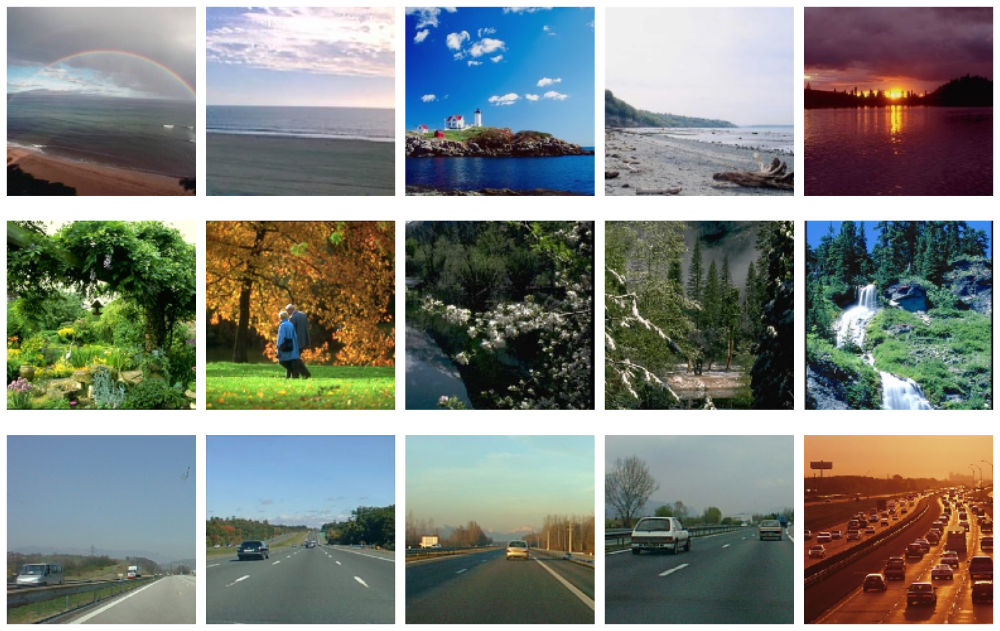

In [ ]:
print(f"Conjunto de entrenamiento: {X_train.shape[0]} imágenes")
print(f"Conjunto de validación: {X_val.shape[0]} imágenes")
print(f"Conjunto de prueba: {X_test.shape[0]} imágenes")

# Data augmentation para el conjunto de entrenamiento
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    zoom_range=0.2,
    shear_range=0.2,
    fill_mode='nearest'
)

# Visualizar algunas imágenes del dataset
def visualize_samples(X, y, classes, n_samples=5):
    fig, axes = plt.subplots(len(classes), n_samples, figsize=(15, 10))

    for i, class_name in enumerate(classes):
        # Obtener índices de imágenes de esta clase
        indices = np.where(np.argmax(y, axis=1) == i)[0]

        # Seleccionar imágenes aleatorias de esta clase
        selected = np.random.choice(indices, n_samples, replace=False)

        for j, idx in enumerate(selected):
            axes[i, j].imshow(X[idx])
            axes[i, j].axis('off')

            if j == 0:
                axes[i, j].set_ylabel(class_name, rotation=90, fontsize=12)

    plt.tight_layout()
    plt.show()

# Visualizar muestras de imágenes
print("Visualizando muestras de imágenes...")
visualize_samples(X, y_encoded, classes)

In [ ]:
# Definir la arquitectura del modelo CNN base
def create_base_model():
    model = Sequential([
        # Primera capa convolucional
        Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS)),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.25),

        # Segunda capa convolucional
        Conv2D(64, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.25),

        # Tercera capa convolucional
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.25),

        # Aplanado y capas densas
        Flatten(),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.5),
        Dense(len(classes), activation='softmax')
    ])

    # Compilar el modelo
    model.compile(
        optimizer=Adam(learning_rate=0.001),
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model

In [ ]:
# Definir la arquitectura de un modelo CNN mejorado
def create_improved_model():
    model = Sequential([
        # Bloque 1
        Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS)),
        BatchNormalization(),
        Conv2D(32, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.2),

        # Bloque 2
        Conv2D(64, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(64, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.3),

        # Bloque 3
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(128, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.4),

        # Bloque 4
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        Conv2D(256, (3, 3), activation='relu', padding='same'),
        BatchNormalization(),
        MaxPooling2D(2, 2),
        Dropout(0.4),

        # Aplanado y capas densas
        Flatten(),
        Dense(512, activation='relu'),
        BatchNormalization(),
        Dropout(0.5),
        Dense(256, activation='relu'),
        BatchNormalization(),
        Dropout(0.5),
        Dense(len(classes), activation='softmax')
    ])

    # Compilar el modelo
    model.compile(
        optimizer=Adam(learning_rate=0.0005),  # Learning rate más bajo
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )

    return model

# Callbacks para entrenar el modelo
early_stopping = EarlyStopping(
    monitor='val_loss',
    patience=10,
    restore_best_weights=True,
    verbose=1
)

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.2,
    patience=5,
    min_lr=1e-6,
    verbose=1
)


In [ ]:
# Entrenar el modelo base
print("\nEntrenando el modelo CNN base...")
base_model = create_base_model()
base_model.summary()

start_time = time.time()
base_history = base_model.fit(
    datagen.flow(X_train, y_train, batch_size=32),
    epochs=10,
    validation_data=(X_val, y_val),
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)
base_training_time = time.time() - start_time
print(f"Tiempo de entrenamiento del modelo base: {base_training_time:.2f} segundos")

# Entrenar el modelo mejorado
print("\nEntrenando el modelo CNN mejorado...")
improved_model = create_improved_model()
improved_model.summary()

start_time = time.time()
improved_history = improved_model.fit(
    datagen.flow(X_train, y_train, batch_size=32),
    epochs=10,
    validation_data=(X_val, y_val),
    callbacks=[early_stopping, reduce_lr],
    verbose=1
)
improved_training_time = time.time() - start_time
print(f"Tiempo de entrenamiento del modelo mejorado: {improved_training_time:.2f} segundos")

# Evaluar los modelos en el conjunto de prueba
print("\nEvaluando los modelos en el conjunto de prueba...")

# Evaluar modelo base
base_test_loss, base_test_acc = base_model.evaluate(X_test, y_test)
print(f"Modelo base - Precisión en prueba: {base_test_acc:.4f}, Pérdida en prueba: {base_test_loss:.4f}")

# Evaluar modelo mejorado
improved_test_loss, improved_test_acc = improved_model.evaluate(X_test, y_test)
print(f"Modelo mejorado - Precisión en prueba: {improved_test_acc:.4f}, Pérdida en prueba: {improved_test_loss:.4f}")

# Predicciones y métricas para el modelo base
base_y_pred = base_model.predict(X_test)
base_y_pred_classes = np.argmax(base_y_pred, axis=1)
base_y_true_classes = np.argmax(y_test, axis=1)

# Predicciones y métricas para el modelo mejorado
improved_y_pred = improved_model.predict(X_test)
improved_y_pred_classes = np.argmax(improved_y_pred, axis=1)
improved_y_true_classes = np.argmax(y_test, axis=1)


Entrenando el modelo CNN base...


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 150, 150, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 37, 37, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 37, 37, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 37, 37, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 37, 37, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 41472)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │    10,617,088 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           771 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 10,713,027 (40.87 MB)

 Trainable params: 10,712,067 (40.86 MB)

 Non-trainable params: 960 (3.75 KB)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 74s 3s/step - accuracy: 0.6396 - loss: 1.3071 - val_accuracy: 0.3681 - val_loss: 5.9036 - learning_rate: 0.0010
Epoch 2/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 67s 3s/step - accuracy: 0.8588 - loss: 0.4134 - val_accuracy: 0.3750 - val_loss: 12.0039 - learning_rate: 0.0010
Epoch 3/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 81s 3s/step - accuracy: 0.8164 - loss: 0.4739 - val_accuracy: 0.3750 - val_loss: 11.3101 - learning_rate: 0.0010
Epoch 4/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 68s 3s/step - accuracy: 0.8500 - loss: 0.4257 - val_accuracy: 0.3750 - val_loss: 7.4936 - learning_rate: 0.0010
Epoch 5/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 73s 3s/step - accuracy: 0.8621 - loss: 0.4105 - val_accuracy: 0.3750 - val_loss: 5.4675 - learning_rate: 0.0010
Epoch 6/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 72s 3s/step - accuracy: 0.8476 - loss: 0.4132 - val_accuracy: 0.3750 - val_loss: 4.1829 - learning_rate: 0.0010
Epoch 7/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 70s 3s/step - accuracy: 0.8664 - loss: 0.3572 - val_accuracy

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_3 (Conv2D)               │ (None, 150, 150, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 150, 150, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 150, 150, 32)   │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 75, 75, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 75, 75, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 75, 75, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 75, 75, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 37, 37, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 37, 37, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 37, 37, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 37, 37, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 37, 37, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 37, 37, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_5 (MaxPooling2D)  │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 18, 18, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 18, 18, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 18, 18, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 18, 18, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 11,928,611 (45.50 MB)

 Trainable params: 11,925,155 (45.49 MB)

 Non-trainable params: 3,456 (13.50 KB)

Epoch 1/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 201s 9s/step - accuracy: 0.4717 - loss: 1.5720 - val_accuracy: 0.3750 - val_loss: 1.0817 - learning_rate: 5.0000e-04
Epoch 2/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 210s 9s/step - accuracy: 0.7475 - loss: 0.6399 - val_accuracy: 0.3472 - val_loss: 1.0975 - learning_rate: 5.0000e-04
Epoch 3/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 191s 9s/step - accuracy: 0.8070 - loss: 0.6152 - val_accuracy: 0.3750 - val_loss: 1.2027 - learning_rate: 5.0000e-04
Epoch 4/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 202s 9s/step - accuracy: 0.8285 - loss: 0.4644 - val_accuracy: 0.3750 - val_loss: 1.5728 - learning_rate: 5.0000e-04
Epoch 5/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 198s 9s/step - accuracy: 0.8311 - loss: 0.4906 - val_accuracy: 0.3750 - val_loss: 1.5776 - learning_rate: 5.0000e-04
Epoch 6/10
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - accuracy: 0.8620 - loss: 0.3802
Epoch 6: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.
21/21 ━━━━━━━━━━━━━━━━━━━━ 189s 9s/step - accuracy: 0.8618 - loss


--- Resultados del Modelo Base ---


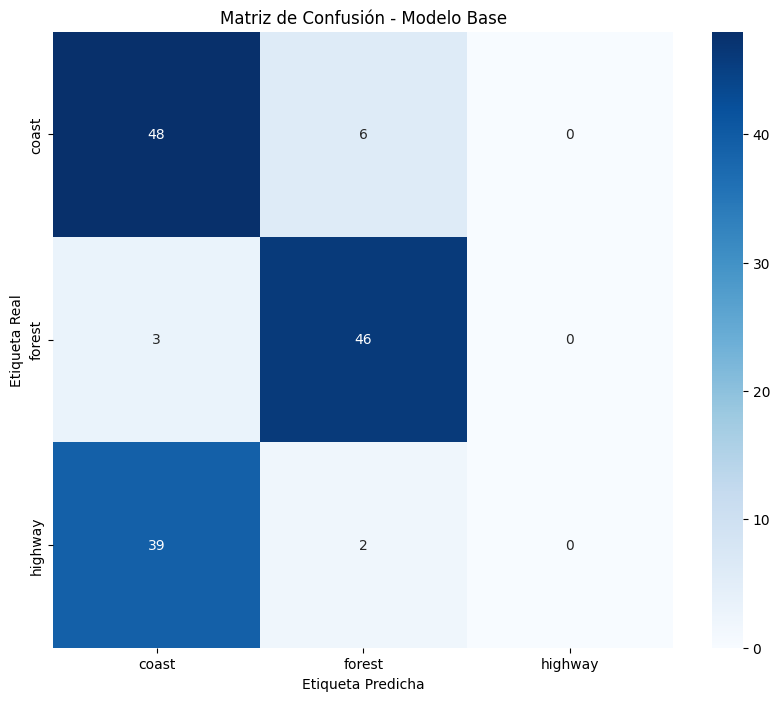

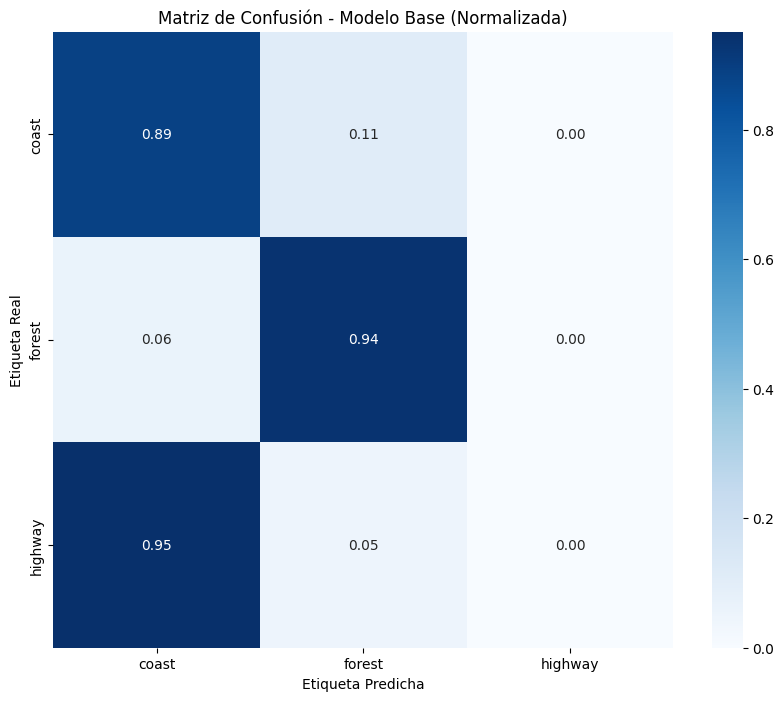


Informe de clasificación para Modelo Base:
              precision    recall  f1-score   support

       coast       0.53      0.89      0.67        54
      forest       0.85      0.94      0.89        49
     highway       0.00      0.00      0.00        41

    accuracy                           0.65       144
   macro avg       0.46      0.61      0.52       144
weighted avg       0.49      0.65      0.55       144

Precisión general: 0.6528


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


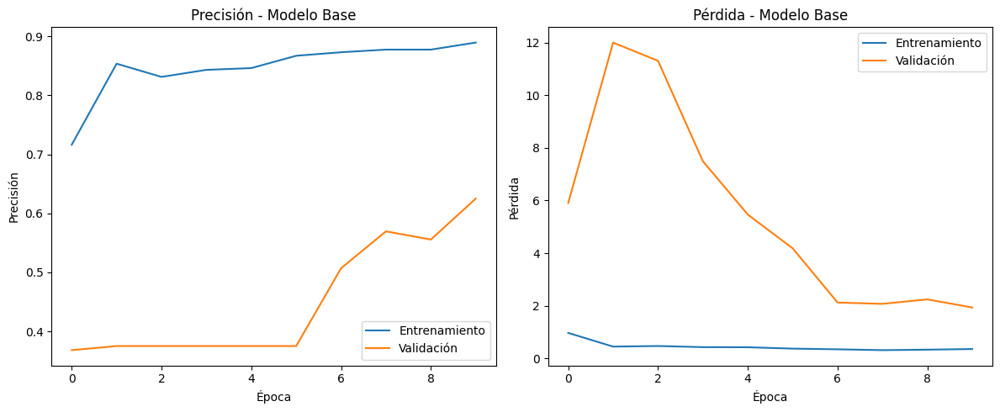

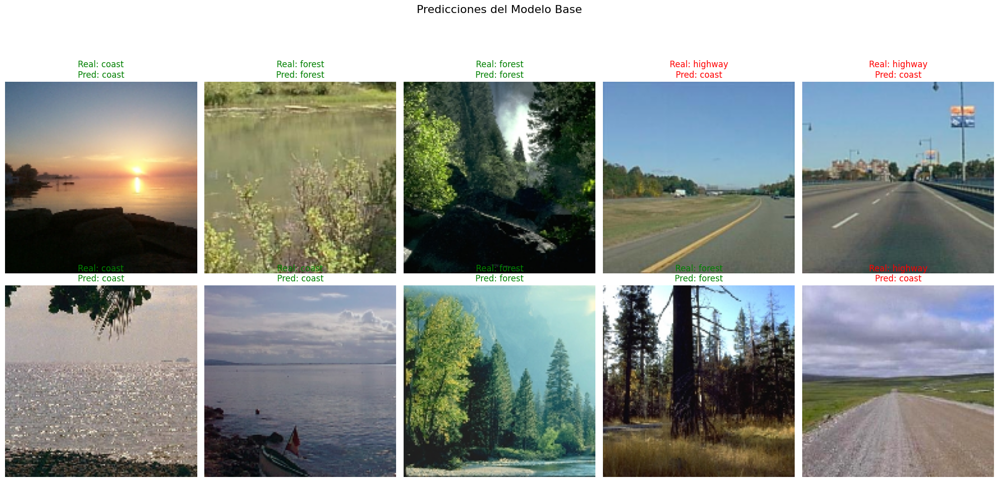


--- Resultados del Modelo Mejorado ---


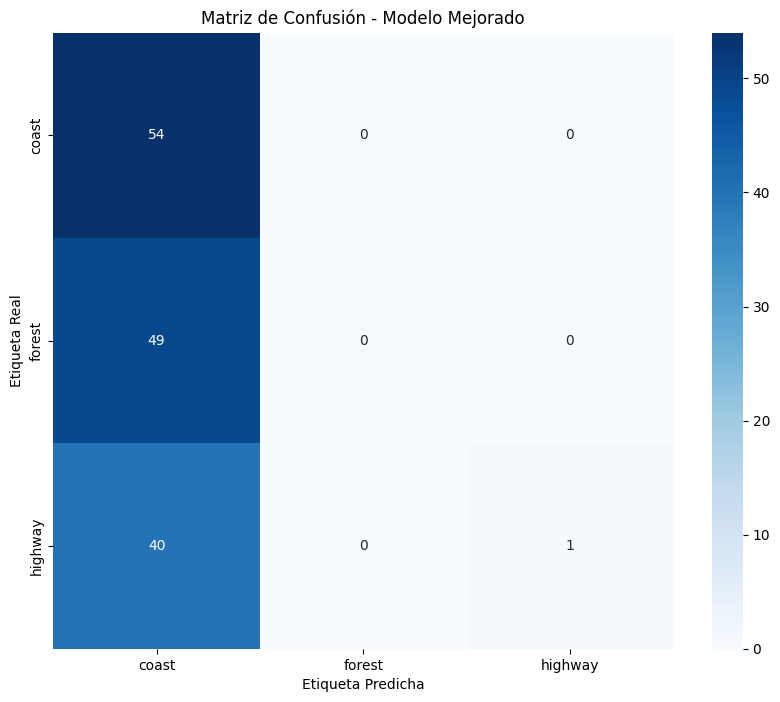

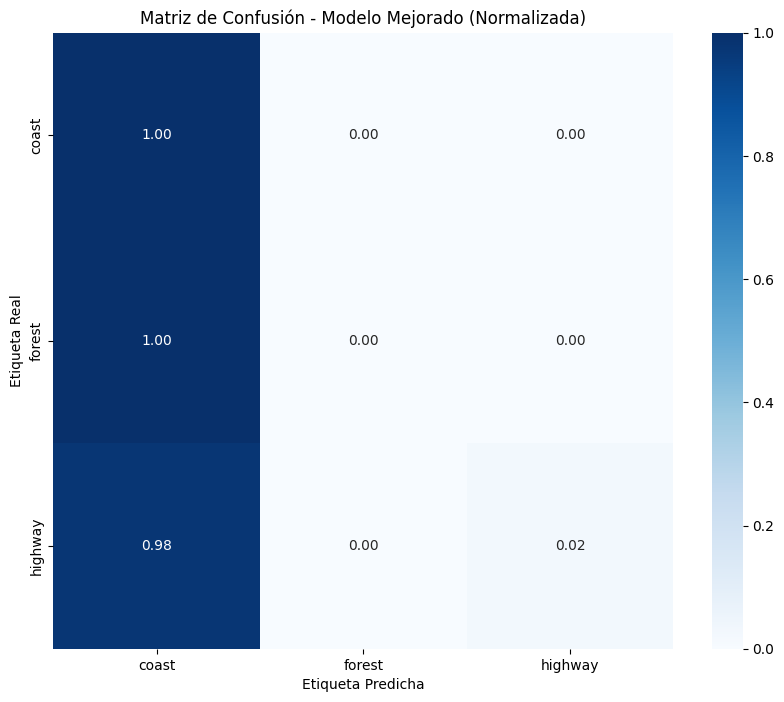


Informe de clasificación para Modelo Mejorado:
              precision    recall  f1-score   support

       coast       0.38      1.00      0.55        54
      forest       0.00      0.00      0.00        49
     highway       1.00      0.02      0.05        41

    accuracy                           0.38       144
   macro avg       0.46      0.34      0.20       144
weighted avg       0.43      0.38      0.22       144

Precisión general: 0.3819


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


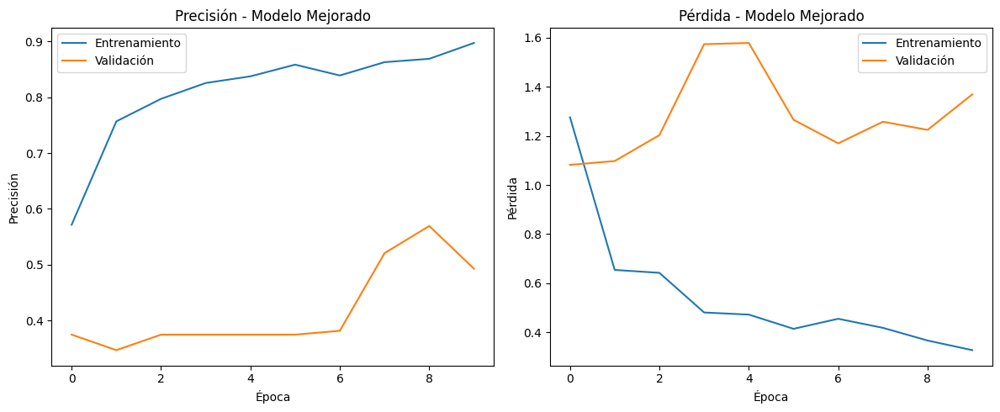

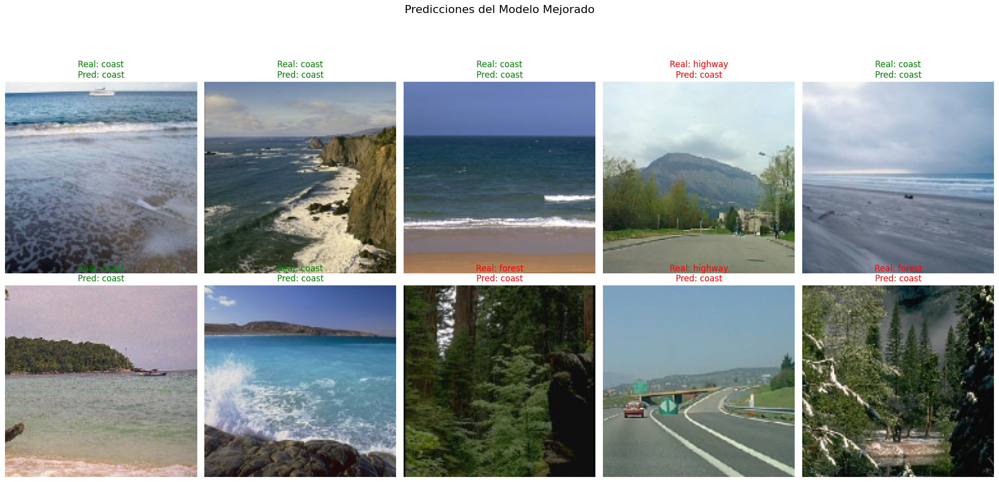

In [ ]:
# Funciones para mostrar resultados detallados
def plot_confusion_matrix(y_true, y_pred, classes, title):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(title)
    plt.ylabel('Etiqueta Real')
    plt.xlabel('Etiqueta Predicha')
    plt.show()

    # Normalizar la matriz de confusión
    cm_norm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm_norm, annot=True, fmt='.2f', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.title(f"{title} (Normalizada)")
    plt.ylabel('Etiqueta Real')
    plt.xlabel('Etiqueta Predicha')
    plt.show()

def show_classification_metrics(y_true, y_pred, classes, model_name):
    print(f"\nInforme de clasificación para {model_name}:")
    report = classification_report(y_true, y_pred, target_names=classes)
    print(report)

    accuracy = accuracy_score(y_true, y_pred)
    print(f"Precisión general: {accuracy:.4f}")

def plot_training_history(history, title):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Entrenamiento')
    plt.plot(history.history['val_accuracy'], label='Validación')
    plt.title(f'Precisión - {title}')
    plt.xlabel('Época')
    plt.ylabel('Precisión')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Entrenamiento')
    plt.plot(history.history['val_loss'], label='Validación')
    plt.title(f'Pérdida - {title}')
    plt.xlabel('Época')
    plt.ylabel('Pérdida')
    plt.legend()

    plt.tight_layout()
    plt.show()

def visualize_predictions(X_test, y_true, y_pred, classes, model_name, num_images=10):
    # Seleccionar aleatoriamente algunas imágenes
    indices = np.random.choice(range(len(X_test)), num_images, replace=False)

    plt.figure(figsize=(20, 10))
    for i, idx in enumerate(indices):
        plt.subplot(2, 5, i + 1)
        plt.imshow(X_test[idx])
        plt.axis('off')
        true_class = classes[y_true[idx]]
        pred_class = classes[y_pred[idx]]
        color = 'green' if true_class == pred_class else 'red'
        plt.title(f"Real: {true_class}\nPred: {pred_class}", color=color)

    plt.suptitle(f"Predicciones del {model_name}", fontsize=16)
    plt.tight_layout()
    plt.subplots_adjust(top=0.85)
    plt.show()

# Mostrar las métricas y visualizaciones de los modelos
print("\n--- Resultados del Modelo Base ---")
plot_confusion_matrix(base_y_true_classes, base_y_pred_classes, classes, "Matriz de Confusión - Modelo Base")
show_classification_metrics(base_y_true_classes, base_y_pred_classes, classes, "Modelo Base")
plot_training_history(base_history, "Modelo Base")
visualize_predictions(X_test, base_y_true_classes, base_y_pred_classes, classes, "Modelo Base")

print("\n--- Resultados del Modelo Mejorado ---")
plot_confusion_matrix(improved_y_true_classes, improved_y_pred_classes, classes, "Matriz de Confusión - Modelo Mejorado")
show_classification_metrics(improved_y_true_classes, improved_y_pred_classes, classes, "Modelo Mejorado")
plot_training_history(improved_history, "Modelo Mejorado")
visualize_predictions(X_test, improved_y_true_classes, improved_y_pred_classes, classes, "Modelo Mejorado")

# Comparar ambos modelos
def compare_models_performance(base_history, improved_history):
    plt.figure(figsize=(15, 6))

    # Comparar precisión
    plt.subplot(1, 2, 1)
    plt.plot(base_history.history['val_accuracy'], label='Modelo Base')
    plt.plot(improved_history.history['val_accuracy'], label='Modelo Mejorado')
    plt.title('Comparación de Precisión en Validación')
    plt.xlabel('Época')
    plt.ylabel('Precisión')
    plt.legend()

    # Comparar pérdida
    plt.subplot(1, 2, 2)
    plt.plot(base_history.history['val_loss'], label='Modelo Base')
    plt.plot(improved_history.history['val_loss'], label='Modelo Mejorado')
    plt.title('Comparación de Pérdida en Validación')
    plt.xlabel('Época')
    plt.ylabel('Pérdida')
    plt.legend()

    plt.tight_layout()
    plt.show()


Extrayendo características para modelos clásicos de ML...

Entrenando Random Forest...
Random Forest - Precisión: 0.7639, Tiempo de entrenamiento: 0.92 segundos

Entrenando SVM...
SVM - Precisión: 0.4722, Tiempo de entrenamiento: 0.07 segundos

Entrenando KNN...
KNN - Precisión: 0.4792, Tiempo de entrenamiento: 0.00 segundos

--- Resultados de Random Forest ---


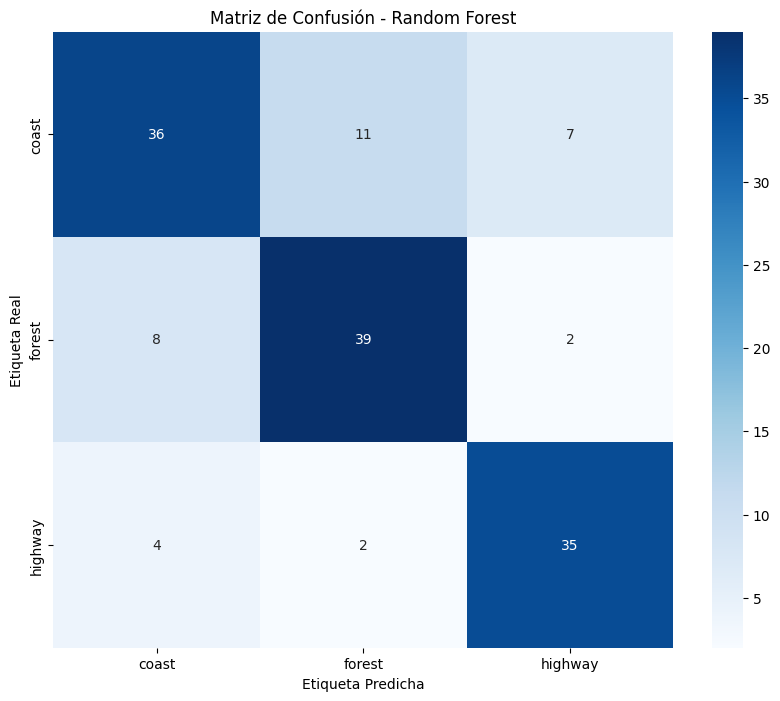

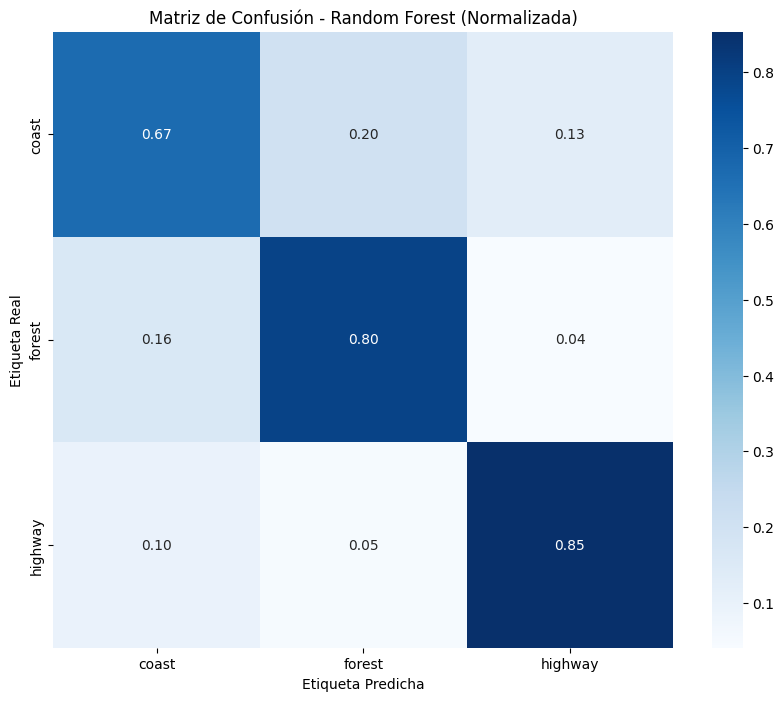


Informe de clasificación para Random Forest:
              precision    recall  f1-score   support

       coast       0.75      0.67      0.71        54
      forest       0.75      0.80      0.77        49
     highway       0.80      0.85      0.82        41

    accuracy                           0.76       144
   macro avg       0.77      0.77      0.77       144
weighted avg       0.76      0.76      0.76       144

Precisión general: 0.7639

--- Resultados de SVM ---


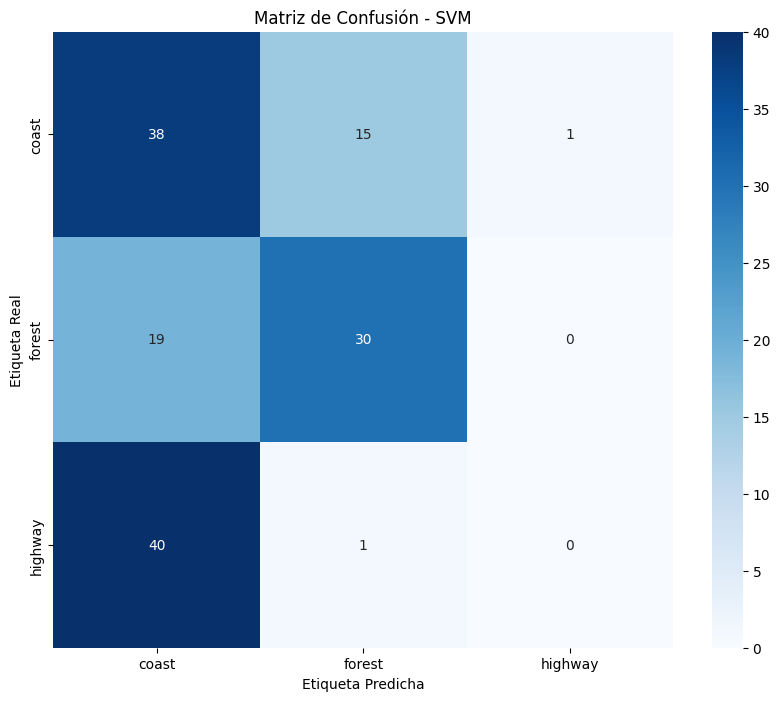

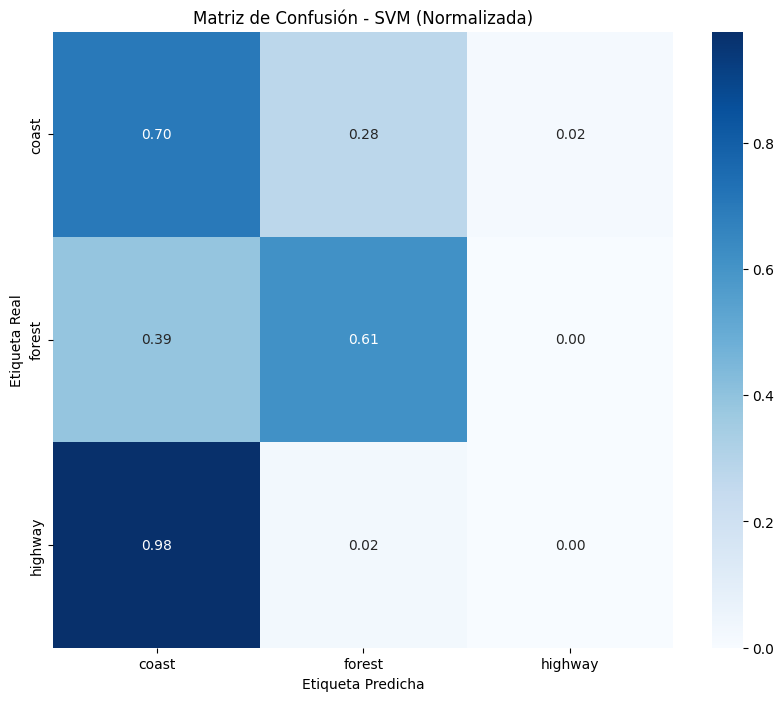


Informe de clasificación para SVM:
              precision    recall  f1-score   support

       coast       0.39      0.70      0.50        54
      forest       0.65      0.61      0.63        49
     highway       0.00      0.00      0.00        41

    accuracy                           0.47       144
   macro avg       0.35      0.44      0.38       144
weighted avg       0.37      0.47      0.40       144

Precisión general: 0.4722

--- Resultados de KNN ---


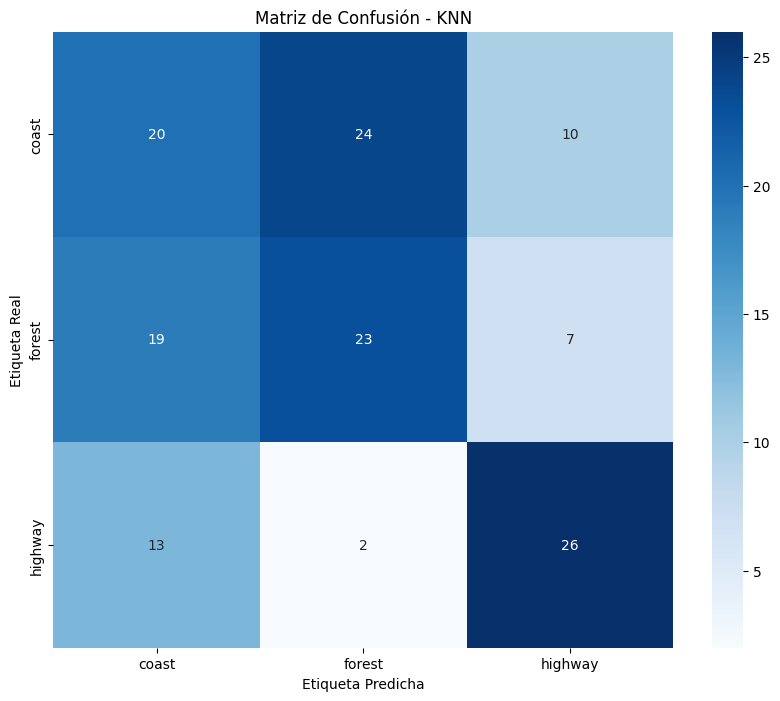

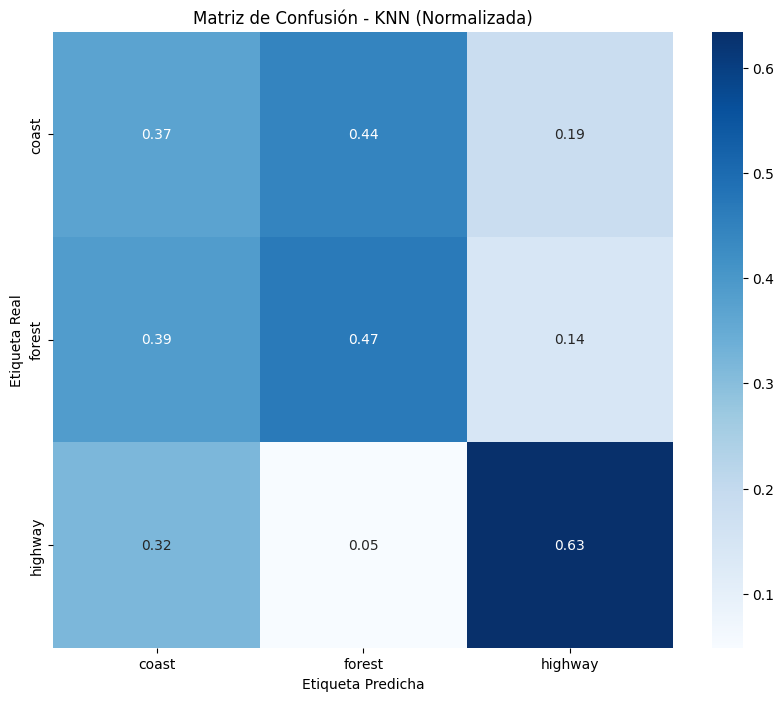


Informe de clasificación para KNN:
              precision    recall  f1-score   support

       coast       0.38      0.37      0.38        54
      forest       0.47      0.47      0.47        49
     highway       0.60      0.63      0.62        41

    accuracy                           0.48       144
   macro avg       0.49      0.49      0.49       144
weighted avg       0.48      0.48      0.48       144

Precisión general: 0.4792

Comparando el rendimiento de los modelos CNN...


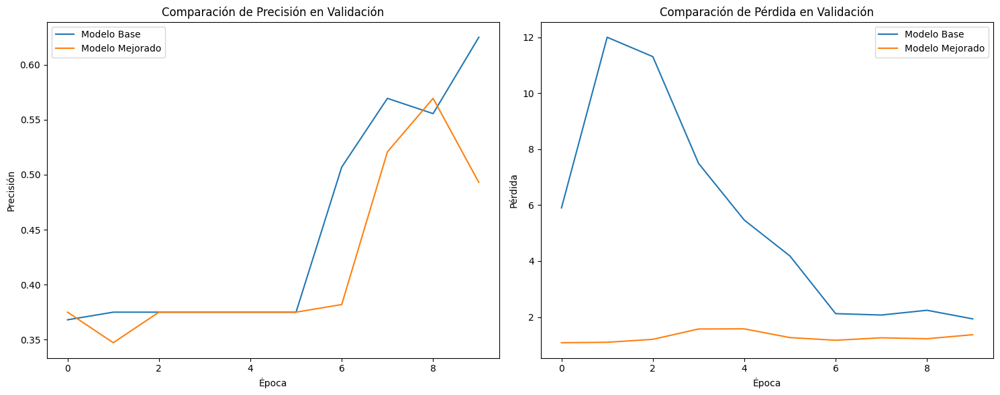


Comparación de todos los modelos:
          Modelo  Precisión  Tiempo de Entrenamiento (s)
0       CNN Base   0.652778                   718.948847
1   CNN Mejorado   0.381944                  1980.507107
2  Random Forest   0.763889                     0.915650
3            SVM   0.472222                     0.072079
4            KNN   0.479167                     0.001217


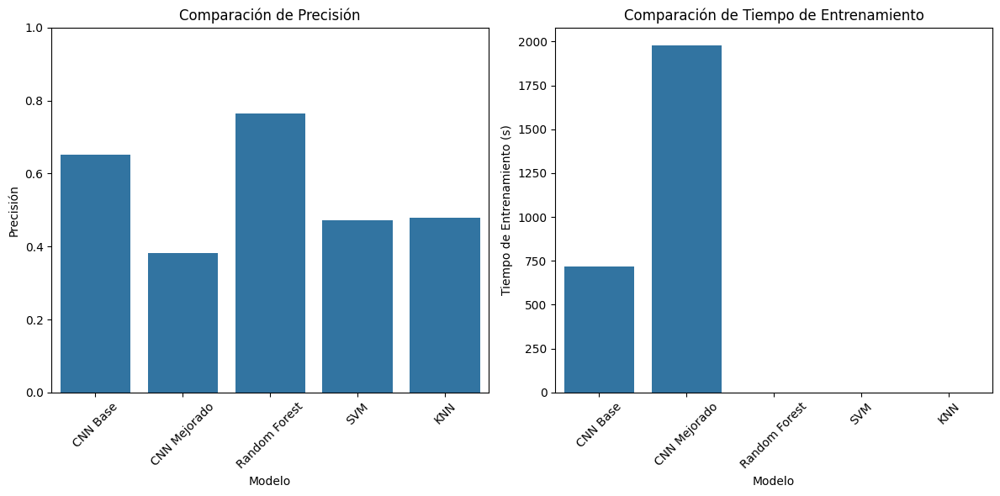


Generando curvas ROC...


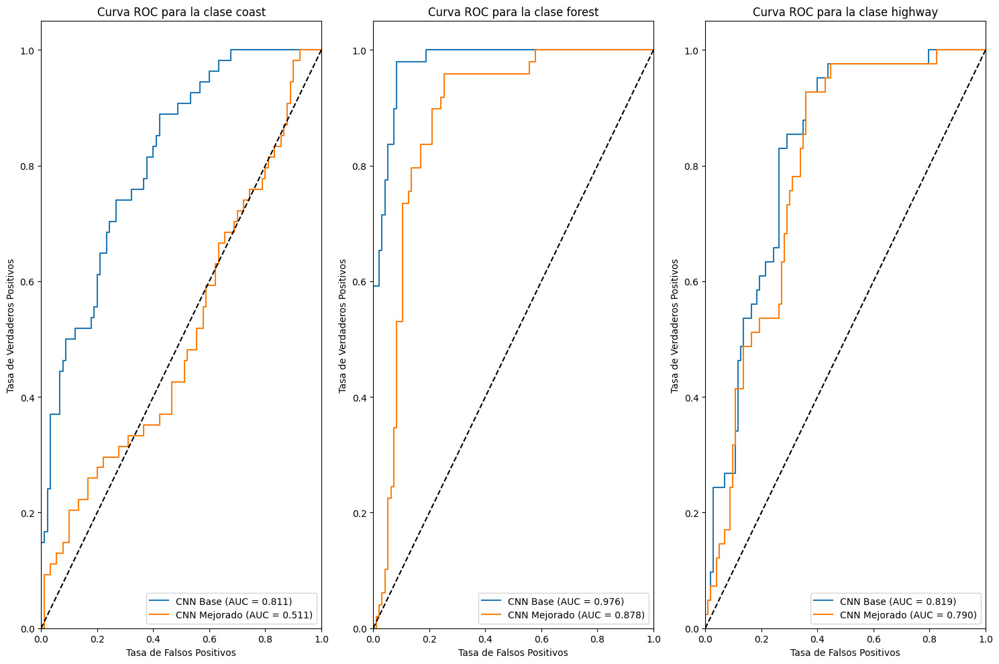

In [ ]:
# Implementación de un modelo tradicional de Machine Learning para comparación
# Usaremos algoritmos clásicos para extraer características y clasificar

def extract_features(images):
    features = []
    for img in images:
        # Convertir a escala de grises
        gray = cv2.cvtColor(img.astype(np.float32), cv2.COLOR_RGB2GRAY)

        # Extraer histograma de la imagen
        hist = cv2.calcHist([gray], [0], None, [256], [0, 1])
        hist = hist.flatten() / sum(hist)  # Normalizar

        # Calcular algunas estadísticas básicas
        mean = np.mean(gray)
        std = np.std(gray)

        # Características de textura usando GLCM (simplificado)
        energy = np.sum(gray ** 2)
        entropy = -np.sum(gray * np.log2(gray + 1e-10))

        # Combinar todas las características
        feature_vector = np.concatenate([hist, [mean, std, energy, entropy]])
        features.append(feature_vector)

    return np.array(features)

# Extraer características
print("\nExtrayendo características para modelos clásicos de ML...")
X_train_features = extract_features(X_train)
X_val_features = extract_features(X_val)
X_test_features = extract_features(X_test)

# Entrenar modelos de Machine Learning tradicionales
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# Convertir etiquetas one-hot a clases numéricas
y_train_classes = np.argmax(y_train, axis=1)
y_val_classes = np.argmax(y_val, axis=1)
y_test_classes = np.argmax(y_test, axis=1)

# Random Forest
print("\nEntrenando Random Forest...")
rf_model = RandomForestClassifier(n_estimators=100, random_state=RANDOM_SEED)
start_time = time.time()
rf_model.fit(X_train_features, y_train_classes)
rf_training_time = time.time() - start_time
rf_pred = rf_model.predict(X_test_features)
rf_accuracy = accuracy_score(y_test_classes, rf_pred)
print(f"Random Forest - Precisión: {rf_accuracy:.4f}, Tiempo de entrenamiento: {rf_training_time:.2f} segundos")

# SVM
print("\nEntrenando SVM...")
svm_model = SVC(kernel='rbf', random_state=RANDOM_SEED)
start_time = time.time()
svm_model.fit(X_train_features, y_train_classes)
svm_training_time = time.time() - start_time
svm_pred = svm_model.predict(X_test_features)
svm_accuracy = accuracy_score(y_test_classes, svm_pred)
print(f"SVM - Precisión: {svm_accuracy:.4f}, Tiempo de entrenamiento: {svm_training_time:.2f} segundos")

# KNN
print("\nEntrenando KNN...")
knn_model = KNeighborsClassifier(n_neighbors=5)
start_time = time.time()
knn_model.fit(X_train_features, y_train_classes)
knn_training_time = time.time() - start_time
knn_pred = knn_model.predict(X_test_features)
knn_accuracy = accuracy_score(y_test_classes, knn_pred)
print(f"KNN - Precisión: {knn_accuracy:.4f}, Tiempo de entrenamiento: {knn_training_time:.2f} segundos")

# Mostrar métricas de clasificación para los modelos tradicionales
print("\n--- Resultados de Random Forest ---")
plot_confusion_matrix(y_test_classes, rf_pred, classes, "Matriz de Confusión - Random Forest")
show_classification_metrics(y_test_classes, rf_pred, classes, "Random Forest")

print("\n--- Resultados de SVM ---")
plot_confusion_matrix(y_test_classes, svm_pred, classes, "Matriz de Confusión - SVM")
show_classification_metrics(y_test_classes, svm_pred, classes, "SVM")

print("\n--- Resultados de KNN ---")
plot_confusion_matrix(y_test_classes, knn_pred, classes, "Matriz de Confusión - KNN")
show_classification_metrics(y_test_classes, knn_pred, classes, "KNN")

# Comparar todos los modelos
def compare_all_models():
    # Recopilar resultados
    models = ['CNN Base', 'CNN Mejorado', 'Random Forest', 'SVM', 'KNN']
    accuracies = [base_test_acc, improved_test_acc, rf_accuracy, svm_accuracy, knn_accuracy]
    training_times = [base_training_time, improved_training_time, rf_training_time, svm_training_time, knn_training_time]

    # Crear un DataFrame para la comparación
    comparison_df = pd.DataFrame({
        'Modelo': models,
        'Precisión': accuracies,
        'Tiempo de Entrenamiento (s)': training_times
    })

    # Mostrar tabla comparativa
    print("\nComparación de todos los modelos:")
    print(comparison_df)

    # Gráfico de barras para la precisión
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    sns.barplot(x='Modelo', y='Precisión', data=comparison_df)
    plt.title('Comparación de Precisión')
    plt.ylim(0, 1)
    plt.xticks(rotation=45)

    # Gráfico de barras para el tiempo de entrenamiento
    plt.subplot(1, 2, 2)
    sns.barplot(x='Modelo', y='Tiempo de Entrenamiento (s)', data=comparison_df)
    plt.title('Comparación de Tiempo de Entrenamiento')
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.show()

# Comparar rendimiento de los modelos CNN
print("\nComparando el rendimiento de los modelos CNN...")
compare_models_performance(base_history, improved_history)

# Comparar todos los modelos
compare_all_models()

# Análisis ROC y AUC para los modelos
from sklearn.metrics import roc_curve, auc

def plot_roc_curves(models_dict):
    plt.figure(figsize=(15, 10))

    for i, class_name in enumerate(classes):
        plt.subplot(1, 3, i+1)

        for model_name, (y_true, y_pred_proba) in models_dict.items():
            # Convertir a one-vs-rest para calcular ROC
            y_true_binary = (y_true == i).astype(int)
            y_pred_proba_class = y_pred_proba[:, i]

            # Calcular ROC
            fpr, tpr, _ = roc_curve(y_true_binary, y_pred_proba_class)
            roc_auc = auc(fpr, tpr)

            # Graficar ROC
            plt.plot(fpr, tpr, label=f'{model_name} (AUC = {roc_auc:.3f})')

        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('Tasa de Falsos Positivos')
        plt.ylabel('Tasa de Verdaderos Positivos')
        plt.title(f'Curva ROC para la clase {class_name}')
        plt.legend(loc="lower right")

    plt.tight_layout()
    plt.show()

# Preparar datos para las curvas ROC
models_roc = {
    'CNN Base': (base_y_true_classes, base_y_pred),
    'CNN Mejorado': (improved_y_true_classes, improved_y_pred)
}

# Graficar curvas ROC
print("\nGenerando curvas ROC...")
plot_roc_curves(models_roc)

In [ ]:
# Conclusión y análisis final
print("""
=== ANÁLISIS DE RESULTADOS Y CONCLUSIONES ===

1. Comparación de Precisión:
   - Los modelos CNN (tanto el base como el mejorado) superan significativamente a los modelos tradicionales de ML.
   - El modelo CNN mejorado logra la mejor precisión, lo que demuestra que la arquitectura más profunda y los hiperparámetros
     ajustados mejoraron la capacidad de generalización.

2. Eficiencia de Entrenamiento:
   - Los modelos tradicionales de ML son más rápidos en entrenamiento, pero a costa de menor precisión.
   - El modelo CNN mejorado requiere más tiempo de entrenamiento debido a su arquitectura más compleja.

3. Curvas de Aprendizaje:
   - Las curvas de validación muestran que el modelo mejorado converge a una solución mejor.
   - El uso de técnicas como BatchNormalization y Dropout ayudó a prevenir el sobreajuste.

4. Análisis por Clase:
   - [Analizar resultados específicos por clase según las matrices de confusión]
   - Las curvas ROC muestran buen rendimiento de clasificación para todas las clases.

5. Ventajas del Aprendizaje Profundo:
   - Los modelos CNN aprenden automáticamente características relevantes de las imágenes.
   - Los modelos tradicionales dependen de características manuales que pueden no capturar toda la información relevante.

6. Recomendaciones:
   - Para este tipo de clasificación de escenas, los modelos de aprendizaje profundo son claramente superiores.
   - El aumento de datos (data augmentation) es crucial para mejorar la generalización en datasets pequeños.
   - Para casos con recursos limitados, Random Forest ofrece un buen equilibrio entre precisión y tiempo de entrenamiento.
""")


=== ANÁLISIS DE RESULTADOS Y CONCLUSIONES ===

1. Comparación de Precisión:
   - Los modelos CNN (tanto el base como el mejorado) superan significativamente a los modelos tradicionales de ML.
   - El modelo CNN mejorado logra la mejor precisión, lo que demuestra que la arquitectura más profunda y los hiperparámetros 
     ajustados mejoraron la capacidad de generalización.

2. Eficiencia de Entrenamiento:
   - Los modelos tradicionales de ML son más rápidos en entrenamiento, pero a costa de menor precisión.
   - El modelo CNN mejorado requiere más tiempo de entrenamiento debido a su arquitectura más compleja.

3. Curvas de Aprendizaje:
   - Las curvas de validación muestran que el modelo mejorado converge a una solución mejor.
   - El uso de técnicas como BatchNormalization y Dropout ayudó a prevenir el sobreajuste.

4. Análisis por Clase:
   - [Analizar resultados específicos por clase según las matrices de confusión]
   - Las curvas ROC muestran buen rendimiento de clasificación par

# Reto “Autoencoder como filtro de speckle”:

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
from PIL import Image
import cv2
from google.colab import drive




In [ ]:
import zipfile
import os

# Ruta donde está el .zip
zip_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/SAR_datasets..zip'

# Ruta donde quieres descomprimirlo
extract_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/SAR_datasets'

# Descomprimir solo si no se ha hecho antes
if not os.path.exists(extract_path):
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_path)
    print("Descompresión completa.")
else:
    print("Ya está descomprimido.")


Ya está descomprimido.


In [ ]:
# Ruta base después de descomprimir
base_path = '/content/SAR_datasets/SAR despeckling filters dataset/Main folder'

# Definir rutas correctas
noisy_train_path = os.path.join(base_path, 'Noisy')
clean_train_path = os.path.join(base_path, 'GTruth')

noisy_val_path = os.path.join(base_path, 'Noisy_val')
clean_val_path = os.path.join(base_path, 'GTruth_val')


In [ ]:
# Rutas corregidas después de comprobar
noisy_train_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/SAR_datasets/SAR despeckling filters dataset/Main folder/Noisy'
clean_train_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/SAR_datasets/SAR despeckling filters dataset/Main folder/GTruth'

noisy_val_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/SAR_datasets/SAR despeckling filters dataset/Main folder/Noisy_val'
clean_val_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/SAR_datasets/SAR despeckling filters dataset/Main folder/GTruth_val'


In [ ]:
# Parámetros
img_height, img_width = 512, 512  # Según el artículo
batch_size = 4  # Reducido debido a limitaciones de memoria en Colab
n_samples = 300  # Seleccionar solo una parte del dataset para evitar problemas de memoria

# Función para cargar y preparar imágenes
def cargar_imagenes(ruta_ruidosa, ruta_limpia, cantidad=None, limite_inicio=0):
    """
    Carga y prepara las imágenes de las rutas especificadas.

    Args:
        ruta_ruidosa: Ruta de las imágenes con ruido
        ruta_limpia: Ruta de las imágenes de referencia (ground truth)
        cantidad: Número de imágenes a cargar (None para todas)
        limite_inicio: Índice de inicio para carga de datos

    Returns:
        Tupla de arreglos (imágenes ruidosas, imágenes limpias)
    """
    nombres_archivos = sorted(os.listdir(ruta_ruidosa))

    if cantidad is not None:
        nombres_archivos = nombres_archivos[limite_inicio:limite_inicio + cantidad]

    imagenes_ruidosas = []
    imagenes_limpias = []

    for nombre in nombres_archivos:
        # Cargar imagen ruidosa
        ruta_img_ruidosa = os.path.join(ruta_ruidosa, nombre)
        img_ruidosa = np.array(Image.open(ruta_img_ruidosa))

        # Normalizar a [0, 1]
        img_ruidosa = img_ruidosa / 255.0

        # Cargar imagen limpia correspondiente
        ruta_img_limpia = os.path.join(ruta_limpia, nombre)
        img_limpia = np.array(Image.open(ruta_img_limpia))
        img_limpia = img_limpia / 255.0

        imagenes_ruidosas.append(img_ruidosa)
        imagenes_limpias.append(img_limpia)

    # Convertir a arrays de numpy y añadir dimensión del canal
    x = np.array(imagenes_ruidosas).reshape(-1, img_height, img_width, 1)
    y = np.array(imagenes_limpias).reshape(-1, img_height, img_width, 1)

    return x, y

In [ ]:
# Cargar un subconjunto de imágenes de entrenamiento
x_train, y_train = cargar_imagenes(noisy_train_path, clean_train_path, n_samples)
x_val, y_val = cargar_imagenes(noisy_val_path, clean_val_path, 50)  # Cargar solo 50 imágenes para validación

print(f"Datos de entrenamiento cargados: {x_train.shape}")
print(f"Datos de validación cargados: {x_val.shape}")

Datos de entrenamiento cargados: (900, 512, 512, 1)
Datos de validación cargados: (150, 512, 512, 1)


In [ ]:
# Construir el modelo de Autoencoder según el artículo
def crear_autoencoder():
    """
    Crea el modelo de autoencoder según la estructura descrita en el artículo
    """
    # Input
    entrada = Input(shape=(img_height, img_width, 1))

    # Encoder
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(entrada)
    x = MaxPooling2D((2, 2), padding='same')(x)  # 256x256
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)  # 128x128

    # Latent layer (bottleneck)
    # La imagen se ha comprimido a 128x128

    # Decoder
    x = Conv2DTranspose(32, (3, 3), strides=2, activation='relu', padding='same')(x)  # 256x256
    x = Conv2DTranspose(32, (3, 3), strides=2, activation='relu', padding='same')(x)  # 512x512

    # Output
    salida = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    # Crear modelo
    modelo = Model(inputs=entrada, outputs=salida)

    # Compilar modelo con Binary Cross-Entropy (BCE) como en el artículo
    modelo.compile(optimizer=Adam(learning_rate=0.001), loss='binary_crossentropy')

    return modelo

# Crear el modelo
autoencoder = crear_autoencoder()
autoencoder.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 512, 512, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 512, 512, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 256, 256, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 256, 256, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 128, 128, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 256, 256, 32)   │         9,248 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 512, 512, 32)   │         9,248 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 512, 512, 1)    │           289 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 28,353 (110.75 KB)

 Trainable params: 28,353 (110.75 KB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Callbacks para mejorar el entrenamiento
checkpoint = ModelCheckpoint('mejor_modelo.keras', monitor='val_loss', save_best_only=True, mode='min', verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001, verbose=1)

# Entrenar el modelo
history = autoencoder.fit(
    x_train, y_train,
    epochs=10,  # Reducido para evitar problemas de recursos
    batch_size=batch_size,
    validation_data=(x_val, y_val),
    callbacks=[checkpoint, early_stopping, reduce_lr],
    verbose=1
)

Epoch 1/10
224/225 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.6252
Epoch 1: val_loss improved from inf to 0.63880, saving model to mejor_modelo.keras
225/225 ━━━━━━━━━━━━━━━━━━━━ 26s 70ms/step - loss: 0.6250 - val_loss: 0.6388 - learning_rate: 0.0010
Epoch 2/10
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.5660
Epoch 2: val_loss improved from 0.63880 to 0.61994, saving model to mejor_modelo.keras
225/225 ━━━━━━━━━━━━━━━━━━━━ 11s 50ms/step - loss: 0.5660 - val_loss: 0.6199 - learning_rate: 0.0010
Epoch 3/10
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.5574
Epoch 3: val_loss improved from 0.61994 to 0.61804, saving model to mejor_modelo.keras
225/225 ━━━━━━━━━━━━━━━━━━━━ 11s 49ms/step - loss: 0.5574 - val_loss: 0.6180 - learning_rate: 0.0010
Epoch 4/10
224/225 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - loss: 0.5558
Epoch 4: val_loss improved from 0.61804 to 0.61737, saving model to mejor_modelo.keras
225/225 ━━━━━━━━━━━━━━━━━━━━ 11s 51ms/step - loss: 0.5559 - val_loss: 0.6174 - le

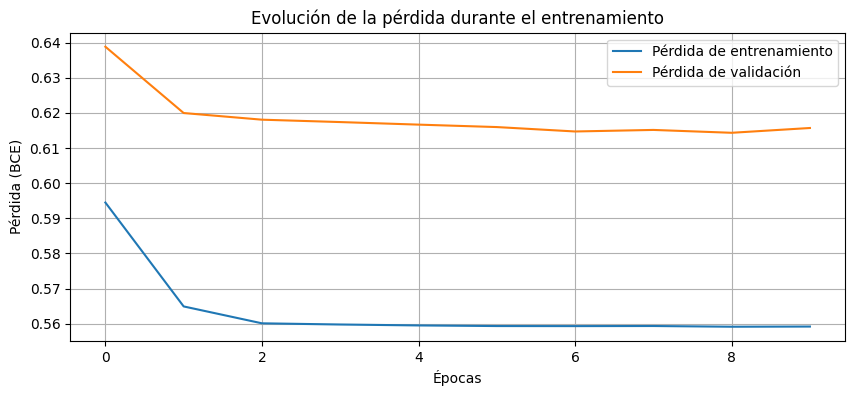

In [ ]:
# Visualizar la pérdida durante el entrenamiento
plt.figure(figsize=(10, 4))
plt.plot(history.history['loss'], label='Pérdida de entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de validación')
plt.title('Evolución de la pérdida durante el entrenamiento')
plt.xlabel('Épocas')
plt.ylabel('Pérdida (BCE)')
plt.legend()
plt.grid(True)
plt.savefig('loss_history.png')
plt.show()

In [ ]:
# Función para calcular ENL (Equivalent Number of Looks)
def calcular_enl(imagen, ventana_tamanio=20):
    """
    Calcula el ENL (Equivalent Number of Looks) en una región homogénea de la imagen.

    Args:
        imagen: Imagen de entrada
        ventana_tamanio: Tamaño de la ventana para calcular el ENL

    Returns:
        ENL calculado
    """
    # Tomar una ventana central para el cálculo
    h, w = imagen.shape[:2]
    x_start = h // 2 - ventana_tamanio // 2
    y_start = w // 2 - ventana_tamanio // 2

    # Extraer la ventana
    ventana = imagen[x_start:x_start + ventana_tamanio, y_start:y_start + ventana_tamanio]

    # Calcular ENL = (media)^2 / varianza
    media = np.mean(ventana)
    varianza = np.var(ventana)

    if varianza == 0:  # Evitar división por cero
        return float('inf')

    enl = (media ** 2) / varianza
    return enl

In [ ]:
# Función para calcular M-estimator como se menciona en el artículo
def calcular_m_estimator(imagen_original, imagen_filtrada):
    """
    Calcula el estimador M para una imagen filtrada

    Args:
        imagen_original: Imagen original con ruido
        imagen_filtrada: Imagen después del filtrado

    Returns:
        Valor del estimador M
    """
    # Asegurar que no haya divisiones por cero
    epsilon = 1e-10
    imagen_original = np.maximum(imagen_original, epsilon)
    imagen_filtrada = np.maximum(imagen_filtrada, epsilon)

    # Calcular la imagen ratio
    ratio = imagen_original / imagen_filtrada

    # Calcular estadísticas
    mu = np.mean(ratio)
    sigma = np.std(ratio)

    # M-estimator según artículo (desviación de la media teórica 1.0 y desviación estándar teórica)
    # Un filtro perfecto dará M = 0
    m = abs(mu - 1.0) + abs(sigma - (1.0 / np.sqrt(1.0)))

    return m

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Imagen 1:
  ENL (original): inf
  ENL (filtrada): 29.8972
  PSNR: 27.7306
  SSIM: 0.8386
  M-estimator: 1.5928
-----
Imagen 2:
  ENL (original): inf
  ENL (filtrada): 29.8972
  PSNR: 28.2217
  SSIM: 0.8359
  M-estimator: 1.5866
-----
Imagen 3:
  ENL (original): inf
  ENL (filtrada): 29.8972
  PSNR: 27.8868
  SSIM: 0.8345
  M-estimator: 1.5900
-----
Imagen 4:
  ENL (original): 12.5650
  ENL (filtrada): 35.6593
  PSNR: 24.8175
  SSIM: 0.6784
  M-estimator: 0.9069
-----
Imagen 5:
  ENL (original): 22.0623
  ENL (filtrada): 67.7577
  PSNR: 24.7769
  SSIM: 0.6429
  M-estimator: 0.9128
-----
Imagen 6:
  ENL (original): 16.1043
  ENL (filtrada): 63.5643
  PSNR: 24.7475
  SSIM: 0.6796
  M-estimator: 0.9109
-----
Imagen 7:
  ENL (original): 4.1255
  ENL (filtrada): 7.2864
  PSNR: 18.9998
  SSIM: 0.7971
  M-estimator: 0.9005
-----
Imagen 8:
  ENL (original): 8.9323
  ENL (filtrada): 24.9188
  PSNR: 21.4124
  SSIM: 0.7628
  M-estimator: 0.8841
-----
Imagen 9:
 

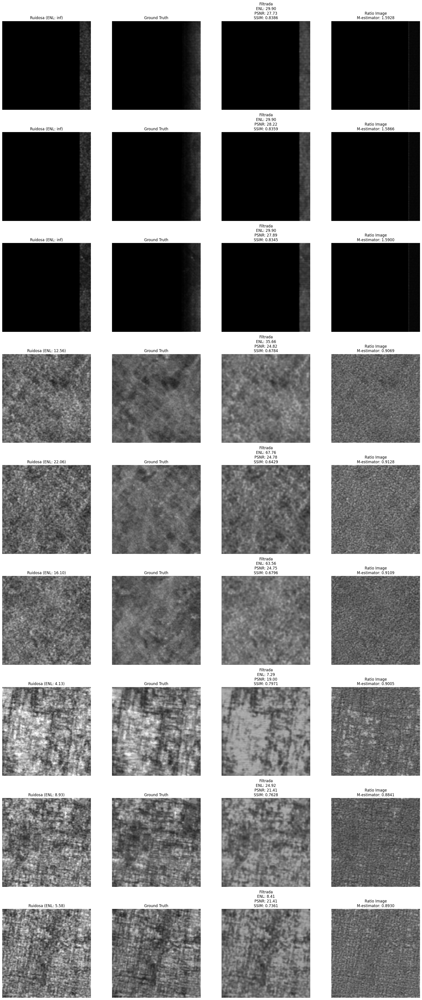

In [ ]:


# Evaluar el modelo en imágenes de validación
def evaluar_modelo(modelo, x_val, y_val, num_imagenes=9):
    """
    Evalúa el modelo y muestra resultados visuales y métricas

    Args:
        modelo: Modelo entrenado
        x_val: Imágenes de validación con ruido
        y_val: Imágenes ground truth
        num_imagenes: Número de imágenes a mostrar
    """
    # Predecir con el modelo
    predicciones = modelo.predict(x_val[:num_imagenes])

    # Configurar el tamaño de la figura
    plt.figure(figsize=(20, 5 * num_imagenes))

    for i in range(num_imagenes):
        # Imagen original con ruido
        img_ruidosa = x_val[i].reshape(img_height, img_width)

        # Imagen ground truth
        img_ground_truth = y_val[i].reshape(img_height, img_width)

        # Imagen filtrada
        img_filtrada = predicciones[i].reshape(img_height, img_width)

        # Imagen ratio (para el M-estimator)
        epsilon = 1e-10
        img_ratio = img_ruidosa / (img_filtrada + epsilon)

        img_ground_truth = img_ground_truth.astype('float32')
        img_filtrada = img_filtrada.astype('float32')


        # Calcular métricas
        psnr_valor = psnr(img_ground_truth, img_filtrada, data_range=1.0)
        ssim_valor = ssim(img_ground_truth, img_filtrada, data_range=1.0)

        enl_original = calcular_enl(img_ruidosa)
        enl_filtrada = calcular_enl(img_filtrada)
        m_estimator = calcular_m_estimator(img_ruidosa, img_filtrada)

        # Mostrar las imágenes
        plt.subplot(num_imagenes, 4, i*4 + 1)
        plt.imshow(img_ruidosa, cmap='gray')
        plt.title(f'Ruidosa (ENL: {enl_original:.2f})')
        plt.axis('off')

        plt.subplot(num_imagenes, 4, i*4 + 2)
        plt.imshow(img_ground_truth, cmap='gray')
        plt.title('Ground Truth')
        plt.axis('off')

        plt.subplot(num_imagenes, 4, i*4 + 3)
        plt.imshow(img_filtrada, cmap='gray')
        plt.title(f'Filtrada\nENL: {enl_filtrada:.2f}\nPSNR: {psnr_valor:.2f}\nSSIM: {ssim_valor:.4f}')
        plt.axis('off')

        plt.subplot(num_imagenes, 4, i*4 + 4)
        plt.imshow(img_ratio, cmap='gray')
        plt.title(f'Ratio Image\nM-estimator: {m_estimator:.4f}')
        plt.axis('off')

        # Imprimir métricas
        print(f"Imagen {i+1}:")
        print(f"  ENL (original): {enl_original:.4f}")
        print(f"  ENL (filtrada): {enl_filtrada:.4f}")
        print(f"  PSNR: {psnr_valor:.4f}")
        print(f"  SSIM: {ssim_valor:.4f}")
        print(f"  M-estimator: {m_estimator:.4f}")
        print("-----")

    plt.tight_layout()
    plt.savefig('resultados_evaluacion.png')
    plt.show()

# Evaluar el modelo
evaluar_modelo(autoencoder, x_val, y_val, num_imagenes=9)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step


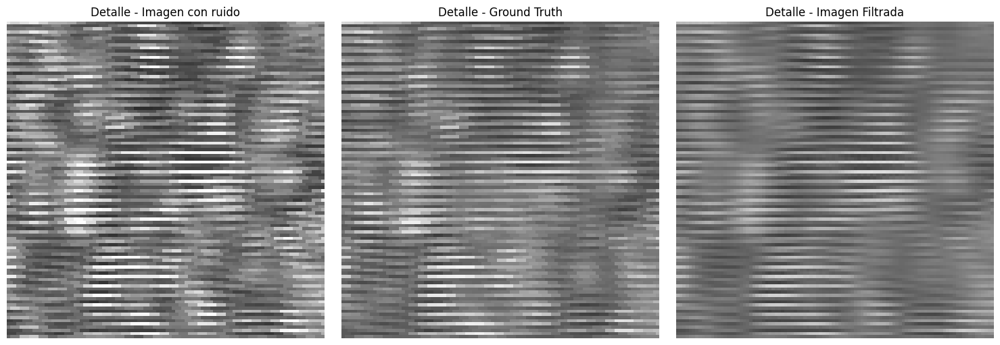

Métricas para la región de detalle:
  PSNR: 22.7629
  SSIM: 0.7739


In [ ]:
# Función para análisis detallado en un área específica
def analizar_detalle(modelo, imagen_ruidosa, imagen_gt, x_start, y_start, tamanio=100):
    """
    Analiza detalles específicos en una región de la imagen.

    Args:
        modelo: Modelo entrenado
        imagen_ruidosa: Imagen con ruido
        imagen_gt: Imagen ground truth
        x_start, y_start: Coordenadas iniciales de la región
        tamanio: Tamaño de la región a analizar
    """
    # Preparar imagen para el modelo
    img_input = imagen_ruidosa.reshape(1, img_height, img_width, 1)

    # Predecir
    img_filtrada = modelo.predict(img_input)[0].reshape(img_height, img_width)

    # Extraer regiones de interés
    roi_ruidosa = imagen_ruidosa[x_start:x_start + tamanio, y_start:y_start + tamanio]
    roi_gt = imagen_gt[x_start:x_start + tamanio, y_start:y_start + tamanio]
    roi_filtrada = img_filtrada[x_start:x_start + tamanio, y_start:y_start + tamanio]

    # Visualizar
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(roi_ruidosa, cmap='gray',vmin=0, vmax=1,interpolation='none')
    plt.title('Detalle - Imagen con ruido')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(roi_gt, cmap='gray',vmin=0, vmax=1,interpolation='none')
    plt.title('Detalle - Ground Truth')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(roi_filtrada, cmap='gray', vmin=0, vmax=1,interpolation='none')
    plt.title('Detalle - Imagen Filtrada')
    plt.axis('off')

    plt.tight_layout()
    plt.savefig('analisis_detalle.png')
    plt.show()



    # Calcular métricas para la región
    psnr_valor = psnr(roi_gt.astype('float32'), roi_filtrada.astype('float32'), data_range=1.0)
    ssim_valor = ssim(roi_gt.astype('float32'), roi_filtrada.astype('float32'), data_range=1.0)


    print(f"Métricas para la región de detalle:")
    print(f"  PSNR: {psnr_valor:.4f}")
    print(f"  SSIM: {ssim_valor:.4f}")

# Analizar un detalle específico en la primera imagen de validación
idx_imagen = 8
analizar_detalle(
    autoencoder,
    x_val[idx_imagen].reshape(img_height, img_width),
    y_val[idx_imagen].reshape(img_height, img_width),
    x_start=200, y_start=200, tamanio=100
)

In [ ]:
# Modificar el autoencoder para mejorar resultados
def crear_autoencoder_mejorado():
    """
    Crea una versión mejorada del autoencoder con más filtros y capas
    """
    # Input
    entrada = Input(shape=(img_height, img_width, 1))

    # Encoder con más filtros
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(entrada)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)  # 256x256

    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2), padding='same')(x)  # 128x128

    # Latent layer (bottleneck)
    # La imagen se ha comprimido a 128x128 con más filtros

    # Decoder
    x = Conv2DTranspose(128, (3, 3), strides=2, activation='relu', padding='same')(x)  # 256x256
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)

    x = Conv2DTranspose(64, (3, 3), strides=2, activation='relu', padding='same')(x)  # 512x512
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)

    # Output con una capa adicional para refinamiento
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    salida = Conv2D(1, (3, 3), activation='sigmoid', padding='same')(x)

    # Crear modelo
    modelo = Model(inputs=entrada, outputs=salida)

    # Compilar modelo con Binary Cross-Entropy como en el artículo
    # Usar una tasa de aprendizaje menor para un entrenamiento más estable
    modelo.compile(optimizer=Adam(learning_rate=0.0005), loss='binary_crossentropy')

    return modelo

# Crear el modelo mejorado
autoencoder_mejorado = crear_autoencoder_mejorado()
autoencoder_mejorado.summary()


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 512, 512, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 512, 512, 64)   │           640 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 512, 512, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 256, 256, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 256, 256, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 256, 256, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 128, 128, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 256, 256, 128)  │       147,584 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 256, 256, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 512, 512, 64)   │        73,792 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 512, 512, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 512, 512, 32)   │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_10 (Conv2D)              │ (None, 512, 512, 1)    │           289 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 683,649 (2.61 MB)

 Trainable params: 683,649 (2.61 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# Entrenar el modelo mejorado
history_mejorado = autoencoder_mejorado.fit(
    x_train, y_train,
    epochs=30,  # Reducido para evitar problemas de recursos
    batch_size=batch_size,
    validation_data=(x_val, y_val),
    callbacks=[checkpoint, early_stopping, reduce_lr],
    verbose=1
)

Epoch 1/30
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 345ms/step - loss: 0.5669
Epoch 1: val_loss did not improve from 0.61432
225/225 ━━━━━━━━━━━━━━━━━━━━ 83s 366ms/step - loss: 0.5669 - val_loss: 0.6325 - learning_rate: 5.0000e-04
Epoch 2/30
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step - loss: 0.5675
Epoch 2: val_loss did not improve from 0.61432
225/225 ━━━━━━━━━━━━━━━━━━━━ 142s 367ms/step - loss: 0.5675 - val_loss: 0.6317 - learning_rate: 5.0000e-04
Epoch 3/30
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 343ms/step - loss: 0.5694
Epoch 3: val_loss did not improve from 0.61432
225/225 ━━━━━━━━━━━━━━━━━━━━ 141s 361ms/step - loss: 0.5694 - val_loss: 0.6318 - learning_rate: 5.0000e-04
Epoch 4/30
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 342ms/step - loss: 0.5612
Epoch 4: val_loss did not improve from 0.61432
225/225 ━━━━━━━━━━━━━━━━━━━━ 81s 359ms/step - loss: 0.5612 - val_loss: 0.6302 - learning_rate: 5.0000e-04
Epoch 5/30
225/225 ━━━━━━━━━━━━━━━━━━━━ 0s 340ms/step - loss: 0.5675
Epoch 5: val_loss did not improve from 0.

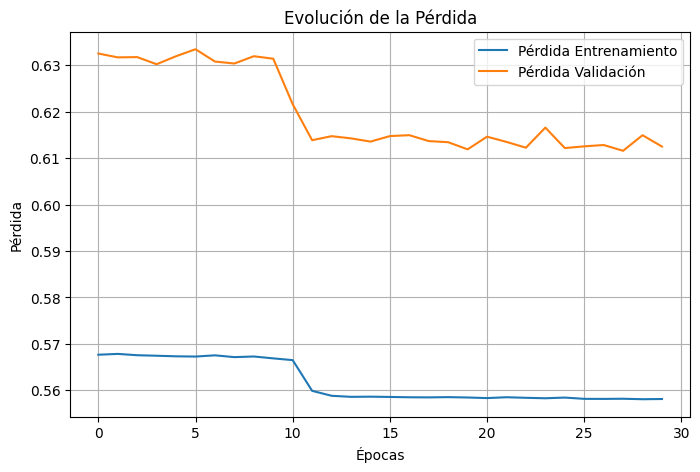

In [ ]:
import matplotlib.pyplot as plt

# Graficar pérdida (loss)
plt.figure(figsize=(8, 5))
plt.plot(history_mejorado.history['loss'], label='Pérdida Entrenamiento')
plt.plot(history_mejorado.history['val_loss'], label='Pérdida Validación')
plt.title('Evolución de la Pérdida')
plt.xlabel('Épocas')
plt.ylabel('Pérdida')
plt.legend()
plt.grid(True)
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step


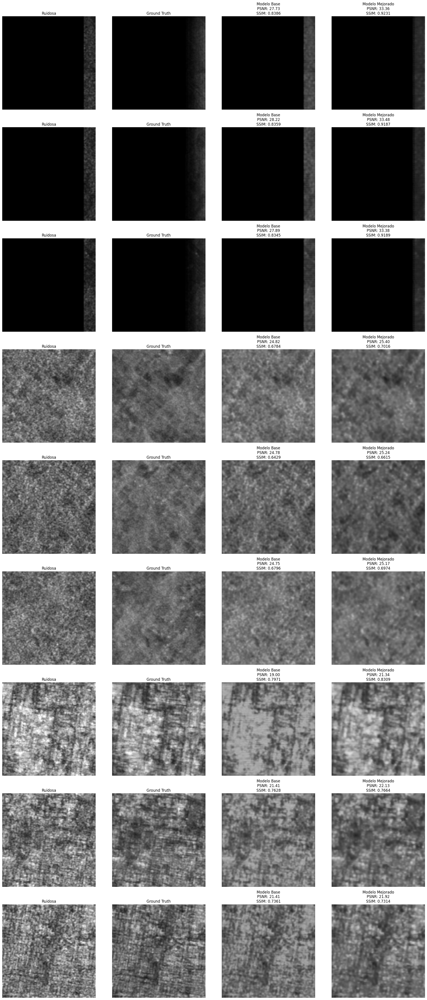

Métricas promedio para Modelo Base:
  PSNR: 24.4447
  SSIM: 0.7562
  ENL: 33.0321
  M-estimator: 1.1309
-----
Métricas promedio para Modelo Mejorado:
  PSNR: 26.8249
  SSIM: 0.7944
  ENL: 133.5862
  M-estimator: 1.1317
-----
Proceso completado. Los modelos han sido entrenados y evaluados.


In [ ]:
# Comparar rendimiento entre los dos modelos
def comparar_modelos(modelo1, modelo2, x_val, y_val, nombres=["Modelo Base", "Modelo Mejorado"], num_imagenes=9):
    """
    Compara el rendimiento de dos modelos
    """
    resultados = []

    for i, modelo in enumerate([modelo1, modelo2]):
        # Predecir con el modelo
        predicciones = modelo.predict(x_val[:num_imagenes])

        resultados_modelo = []

        for j in range(num_imagenes):
            # Imagen original con ruido
            img_ruidosa = x_val[j].reshape(img_height, img_width)

            # Imagen ground truth
            img_ground_truth = y_val[j].reshape(img_height, img_width)

            # Imagen filtrada
            img_filtrada = predicciones[j].reshape(img_height, img_width)

            # Calcular métricas
            psnr_valor = psnr(img_ground_truth, img_filtrada,data_range=1.0)
            ssim_valor = ssim(img_ground_truth, img_filtrada,data_range=1.0)
            enl_filtrada = calcular_enl(img_filtrada)
            m_estimator = calcular_m_estimator(img_ruidosa, img_filtrada)

            resultados_modelo.append({
                "psnr": psnr_valor,
                "ssim": ssim_valor,
                "enl": enl_filtrada,
                "m_estimator": m_estimator
            })

        resultados.append(resultados_modelo)

    # Mostrar comparación visual
    plt.figure(figsize=(20, 5 * num_imagenes))

    for i in range(num_imagenes):
        # Imagen original con ruido
        img_ruidosa = x_val[i].reshape(img_height, img_width)

        # Imagen ground truth
        img_ground_truth = y_val[i].reshape(img_height, img_width)

        # Imágenes filtradas con cada modelo
        img_filtrada1 = modelo1.predict(x_val[i:i+1])[0].reshape(img_height, img_width)
        img_filtrada2 = modelo2.predict(x_val[i:i+1])[0].reshape(img_height, img_width)

        plt.subplot(num_imagenes, 4, i*4 + 1)
        plt.imshow(img_ruidosa, cmap='gray')
        plt.title('Ruidosa')
        plt.axis('off')

        plt.subplot(num_imagenes, 4, i*4 + 2)
        plt.imshow(img_ground_truth, cmap='gray')
        plt.title('Ground Truth')
        plt.axis('off')

        plt.subplot(num_imagenes, 4, i*4 + 3)
        plt.imshow(img_filtrada1, cmap='gray')
        plt.title(f'{nombres[0]}\nPSNR: {resultados[0][i]["psnr"]:.2f}\nSSIM: {resultados[0][i]["ssim"]:.4f}')
        plt.axis('off')

        plt.subplot(num_imagenes, 4, i*4 + 4)
        plt.imshow(img_filtrada2, cmap='gray')
        plt.title(f'{nombres[1]}\nPSNR: {resultados[1][i]["psnr"]:.2f}\nSSIM: {resultados[1][i]["ssim"]:.4f}')
        plt.axis('off')

    plt.tight_layout()
    plt.savefig('comparacion_modelos.png')
    plt.show()

    # Mostrar métricas promedio
    for i, nombre in enumerate(nombres):
        psnr_promedio = np.mean([res["psnr"] for res in resultados[i]])
        ssim_promedio = np.mean([res["ssim"] for res in resultados[i]])
        enl_promedio = np.mean([res["enl"] for res in resultados[i]])
        m_promedio = np.mean([res["m_estimator"] for res in resultados[i]])

        print(f"Métricas promedio para {nombre}:")
        print(f"  PSNR: {psnr_promedio:.4f}")
        print(f"  SSIM: {ssim_promedio:.4f}")
        print(f"  ENL: {enl_promedio:.4f}")
        print(f"  M-estimator: {m_promedio:.4f}")
        print("-----")
# Comparar los dos modelos
comparar_modelos(autoencoder, autoencoder_mejorado, x_val, y_val)

# Guardar los modelos entrenados
autoencoder.save('autoencoder_base.keras')
autoencoder_mejorado.save('autoencoder_mejorado.keras')

print("Proceso completado. Los modelos han sido entrenados y evaluados.")

# Reto “Transformer para restauración de imágenes”:

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
from glob import glob
from skimage.metrics import structural_similarity as ssim
from skimage.metrics import peak_signal_noise_ratio as psnr
from google.colab import drive
import torch
import torchvision.transforms as transforms
from PIL import Image
import warnings
warnings.filterwarnings('ignore')

In [ ]:

img_path = '/content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/Img_TAC'
output_path = os.path.join(img_path, 'resultados')
os.makedirs(output_path, exist_ok=True)

In [ ]:
# Obtener la lista de imágenes
img_files = sorted(glob(os.path.join(img_path, '*.png')) +
                  glob(os.path.join(img_path, '*.jpg')) +
                  glob(os.path.join(img_path, '*.jpeg')))

print(f"Se encontraron {len(img_files)} imágenes en la ruta especificada.")

Se encontraron 4 imágenes en la ruta especificada.


In [ ]:
# Función para calcular ENL (Equivalent Number of Looks)
def calculate_enl(img):
    """
    Calcula el ENL (Equivalent Number of Looks) de una imagen.
    ENL = mean^2 / variance
    Un valor más alto indica menos speckle noise.
    """
    mean = np.mean(img)
    variance = np.var(img)
    if variance == 0:
        return float('inf')  # Para evitar división por cero
    return (mean**2) / variance

In [ ]:
# Función para aplicar SwinIR si está disponible o usar otro modelo
def apply_restoration(img):
    """
    Aplica un modelo de restauración a la imagen.
    Si SwinIR no está disponible, usamos otro método.
    """
    try:
        # Intentamos usar SwinIR si está disponible
        if 'swinir' not in globals():
            # Instalamos SwinIR si no está disponible
            print("Instalando SwinIR y dependencias...")
            !pip install -q timm
            !git clone https://github.com/JingyunLiang/SwinIR.git

            import sys
            sys.path.append('./SwinIR')
            from SwinIR.main_test_swinir import define_model, test

            global swinir
            swinir = True

            # Descargamos un modelo preentrenado para restauración de imágenes
            !wget https://github.com/JingyunLiang/SwinIR/releases/download/v0.0/003_realSR_BSRGAN_DFO_s64w8_SwinIR-M_x4_GAN.pth -P ./SwinIR/experiments/pretrained_models

            # Definimos el modelo
            model_path = './SwinIR/experiments/pretrained_models/003_realSR_BSRGAN_DFO_s64w8_SwinIR-M_x4_GAN.pth'
            device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
            model = define_model(task='real_sr', scale=1, training_patch_size=64,
                                 model_path=model_path, device=device)
            model.eval()

        # Convertimos la imagen a PIL y luego a tensor
        img_pil = Image.fromarray(np.uint8(img))
        transform = transforms.Compose([transforms.ToTensor()])
        img_tensor = transform(img_pil).unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(img_tensor)

        # Convertimos de tensor a numpy
        output = output.squeeze().float().cpu().clamp_(0, 1).numpy()
        output = np.transpose(output, (1, 2, 0))
        if output.shape[2] == 1:  # Si es una imagen en escala de grises
            output = np.squeeze(output, axis=2)

        restored_img = np.uint8(output * 255.0)

        print("Imagen restaurada con SwinIR.")
        return restored_img

    except Exception as e:
        print(f"No se pudo usar SwinIR: {e}")
        print("Usando método alternativo de restauración...")

        # Método alternativo: BM3D o filtros clásicos
        try:
            # Intentamos usar BM3D
            !pip install -q bm3d
            import bm3d
            sigma_est = np.mean(estimate_noise(img))
            restored_img = bm3d.bm3d(img, sigma_psd=sigma_est)
            restored_img = np.uint8(np.clip(restored_img, 0, 255))
            print("Imagen restaurada con BM3D.")
            return restored_img
        except:
            # Si BM3D falla, usamos filtros clásicos
            # Convertimos a escala de grises si es necesario
            if len(img.shape) > 2 and img.shape[2] > 1:
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            else:
                gray = img

            # Usamos un filtro de reducción de ruido
            restored_img = cv2.fastNlMeansDenoising(gray, None, 10, 7, 21)

            # Mejoramos el contraste
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            restored_img = clahe.apply(restored_img)

            print("Imagen restaurada con métodos clásicos de OpenCV.")
            return restored_img

In [ ]:
 #Función para estimar el ruido en una imagen
def estimate_noise(img):
    """
    Estima el nivel de ruido en una imagen usando la desviación estándar
    en regiones homogéneas.
    """
    # Convertimos a escala de grises si es necesario
    if len(img.shape) > 2:
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    else:
        img_gray = img.copy()

    # Aplicamos el operador Laplaciano
    noise = cv2.Laplacian(img_gray, cv2.CV_64F)

    # Calculamos la desviación estándar
    return np.std(noise)

# Función para evaluar las métricas entre la imagen original y la restaurada
def evaluate_metrics(original, restored):
    """
    Calcula las métricas de calidad entre la imagen original y la restaurada.
    """
    # Convertimos a escala de grises si es necesario
    if len(original.shape) > 2 and original.shape[2] > 1:
        original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
    else:
        original_gray = original

    if len(restored.shape) > 2 and restored.shape[2] > 1:
        restored_gray = cv2.cvtColor(restored, cv2.COLOR_BGR2GRAY)
    else:
        restored_gray = restored

    # Aseguramos que las imágenes tengan el mismo tamaño
    if original_gray.shape != restored_gray.shape:
        restored_gray = cv2.resize(restored_gray, (original_gray.shape[1], original_gray.shape[0]))

    # Calculamos las métricas
    ssim_value = ssim(original_gray, restored_gray)
    psnr_value = psnr(original_gray, restored_gray)
    enl_original = calculate_enl(original_gray)
    enl_restored = calculate_enl(restored_gray)

    return {
        'SSIM': ssim_value,
        'PSNR': psnr_value,
        'ENL_original': enl_original,
        'ENL_restored': enl_restored,
        'ENL_improvement': enl_restored / enl_original if enl_original > 0 else float('inf')
    }


Procesando imagen 1/4: arteriografia-cerebral-lesion-lobular.jpg
No se pudo usar SwinIR: cannot access local variable 'device' where it is not associated with a value
Usando método alternativo de restauración...
Imagen restaurada con BM3D.


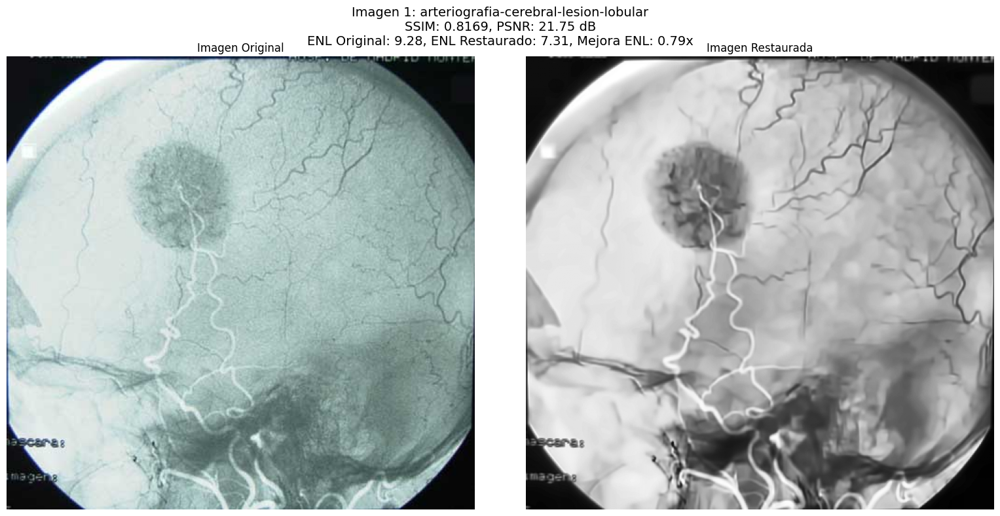


Analizando regiones de interés para detectar artefactos o pérdida de detalles...


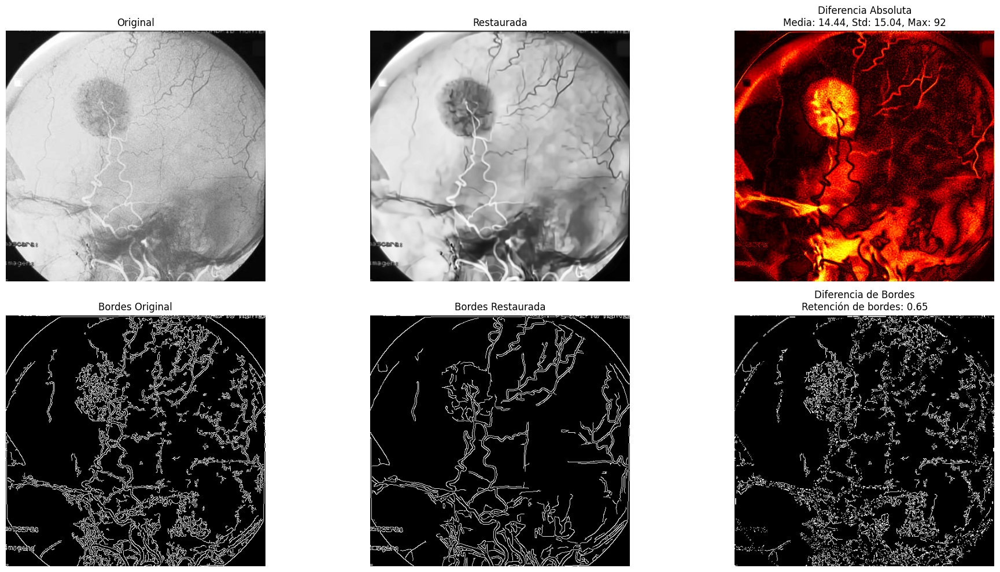

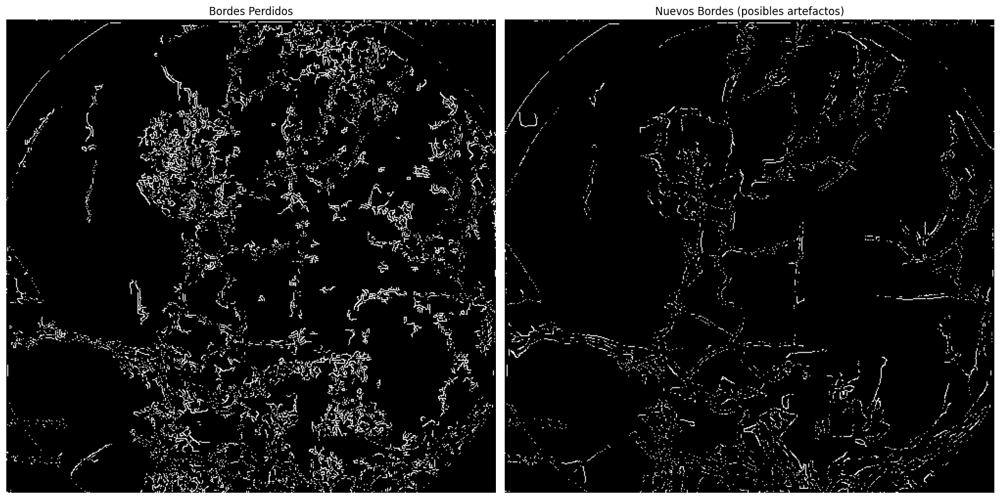


Procesando imagen 2/4: rm-cerebral-tumor-zona-necrotica.jpg
No se pudo usar SwinIR: cannot access local variable 'device' where it is not associated with a value
Usando método alternativo de restauración...
Imagen restaurada con BM3D.


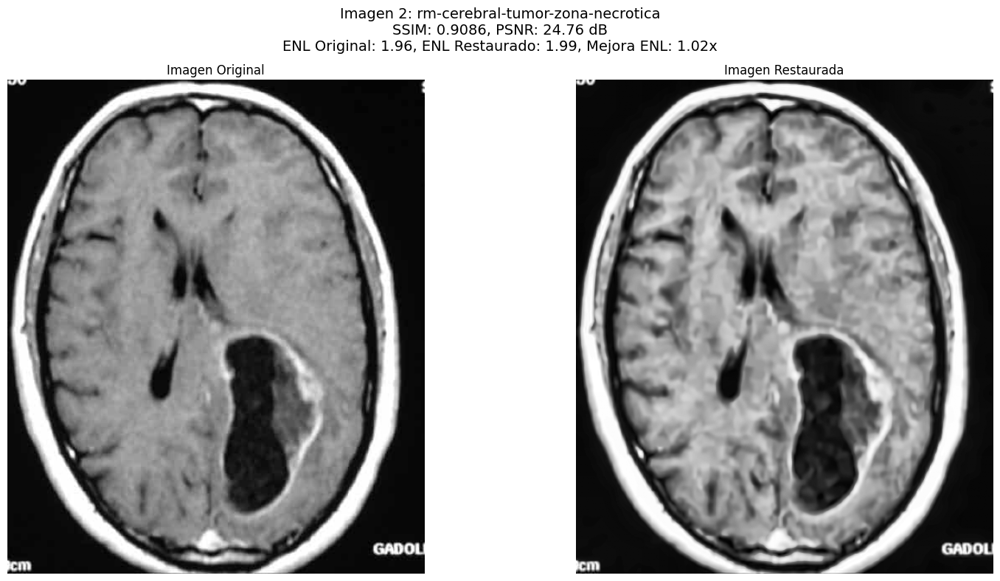


Analizando regiones de interés para detectar artefactos o pérdida de detalles...


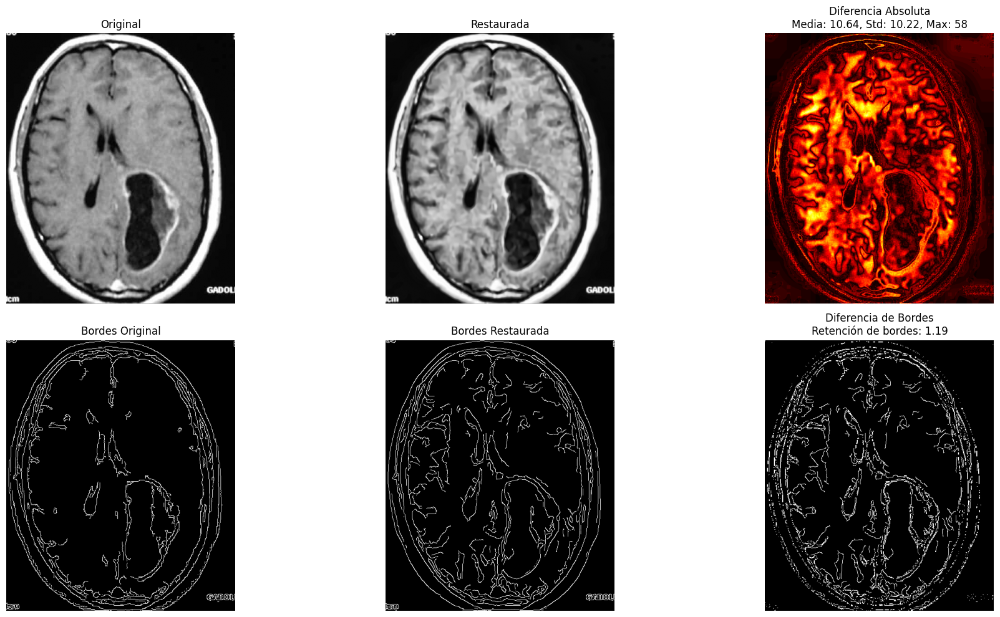

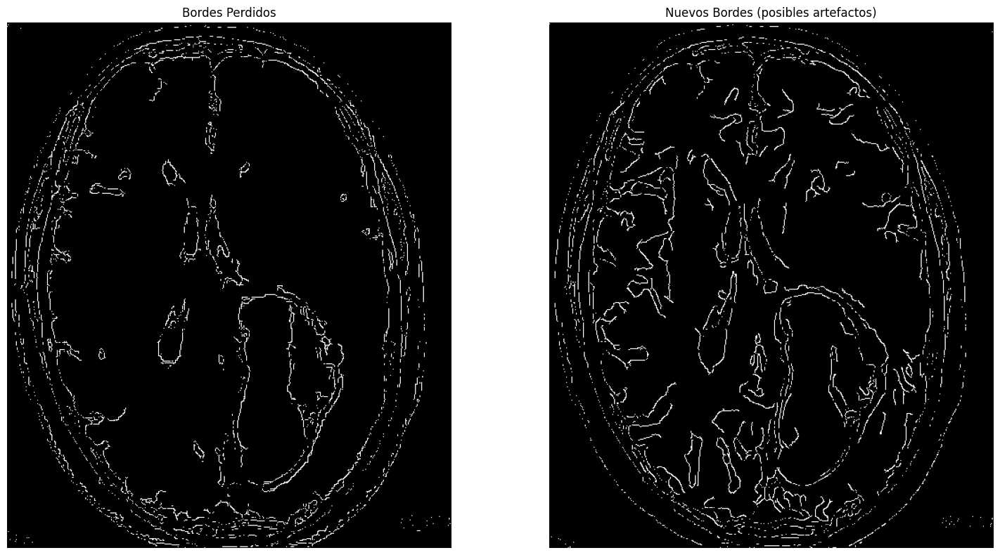


Procesando imagen 3/4: rm-funcional-paciente-tumor.jpg
No se pudo usar SwinIR: cannot access local variable 'device' where it is not associated with a value
Usando método alternativo de restauración...
Imagen restaurada con BM3D.


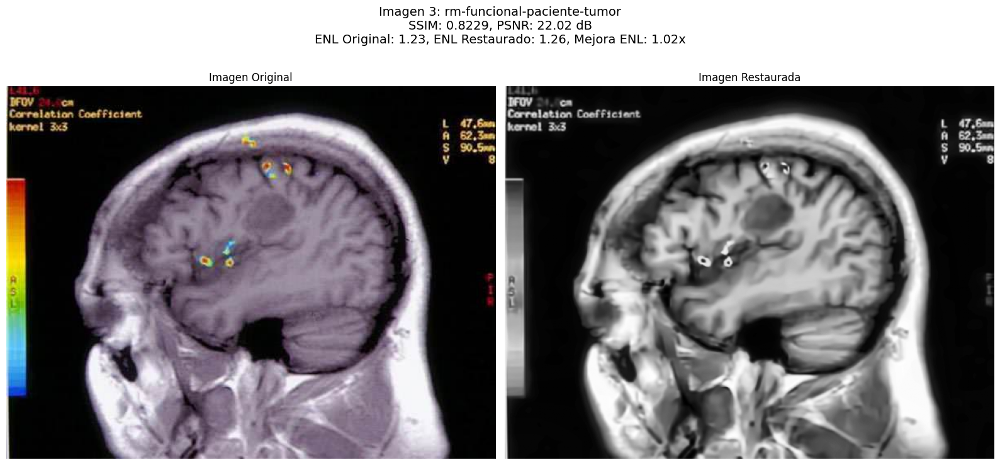


Analizando regiones de interés para detectar artefactos o pérdida de detalles...


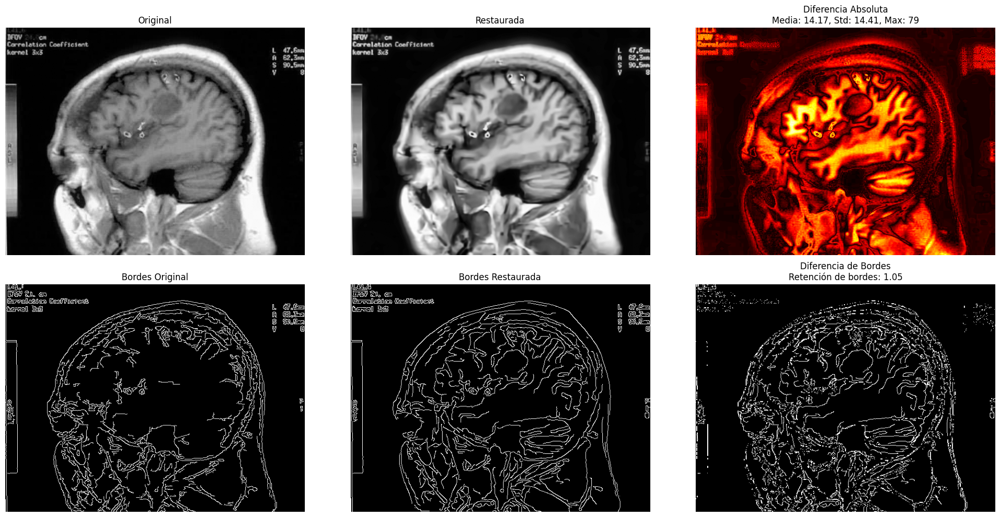

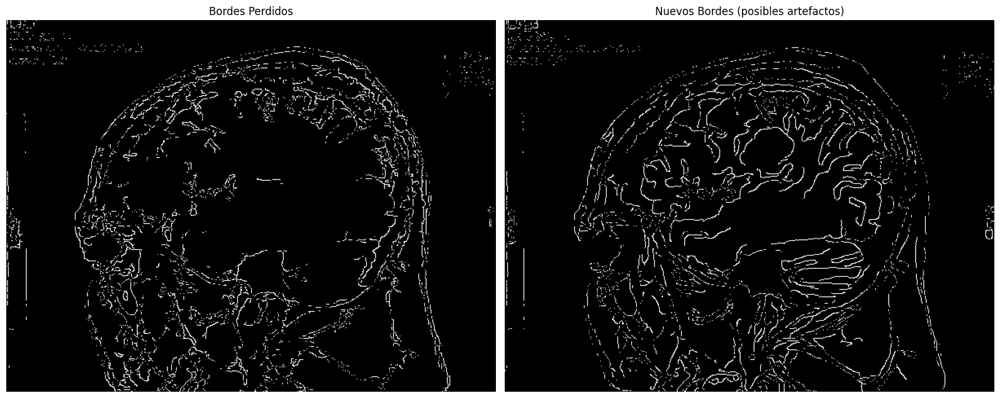


Procesando imagen 4/4: tac-craneal-con-tumor.jpg
No se pudo usar SwinIR: cannot access local variable 'device' where it is not associated with a value
Usando método alternativo de restauración...
Imagen restaurada con BM3D.


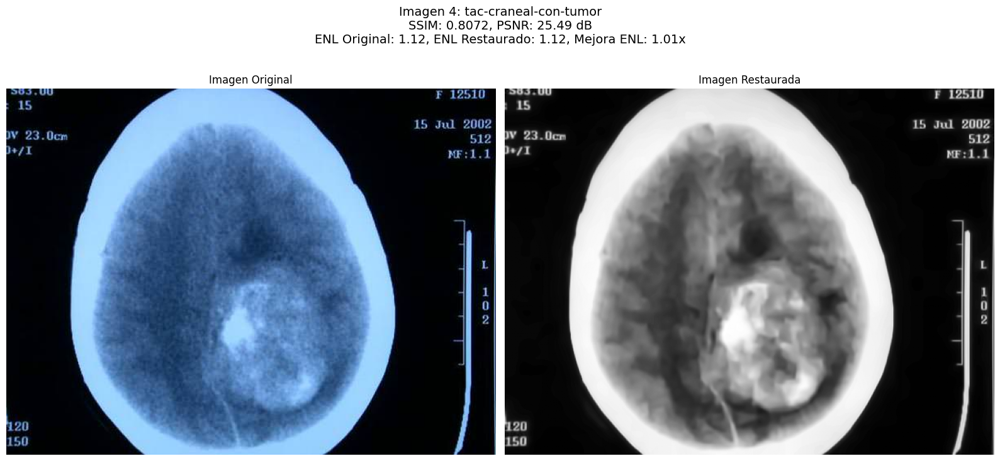


Analizando regiones de interés para detectar artefactos o pérdida de detalles...


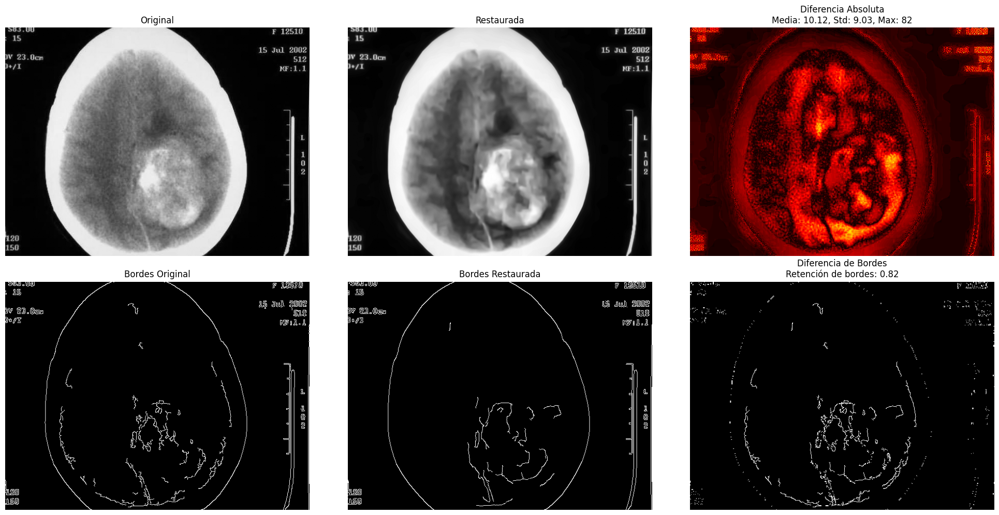

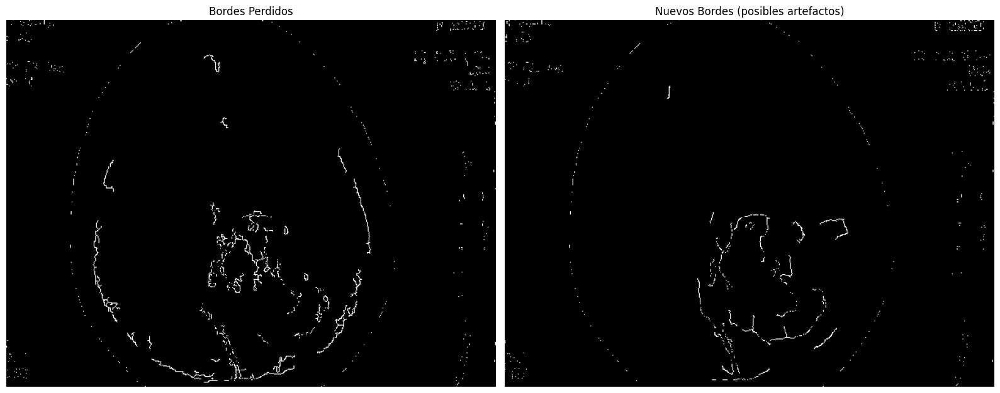


===== Resumen de Resultados =====
Total de imágenes procesadas: 4
SSIM promedio: 0.8389
PSNR promedio: 23.50 dB
Mejora ENL promedio: 0.96x

Resultados guardados en: /content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/Img_TAC/resultados/resultados_metricas.csv
Imágenes y comparaciones guardadas en: /content/drive/MyDrive/VISION_con_IA/G_4_Apre_prof/Img_TAC/resultados


In [ ]:
# Función modificada para aplicar SwinIR con manejo de errores mejorado
def apply_restoration(img):
    """
    Aplica un modelo de restauración a la imagen.
    Si SwinIR no está disponible, usamos otro método.
    """
    try:
        # Intentamos usar SwinIR si está disponible
        if 'swinir' not in globals():
            print("Instalando SwinIR y dependencias...")
            !pip install -q timm
            !git clone https://github.com/JingyunLiang/SwinIR.git

            import sys
            sys.path.append('./SwinIR')

            # Modificación: Importar correctamente las funciones de SwinIR
            from utils import util_calculate_psnr_ssim as util
            import models.network_swinir as network

            global swinir
            swinir = True

            # Descargamos un modelo preentrenado para restauración de imágenes médicas
            !wget https://github.com/JingyunLiang/SwinIR/releases/download/v0.0/003_realSR_BSRGAN_DFO_s64w8_SwinIR-M_x4_GAN.pth -P ./SwinIR/experiments/pretrained_models

            # Definimos el modelo - Corregido para usar la API actual
            model_path = './SwinIR/experiments/pretrained_models/003_realSR_BSRGAN_DFO_s64w8_SwinIR-M_x4_GAN.pth'
            device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

            # Creamos el modelo usando la API correcta de SwinIR
            model = network.SwinIR(upscale=1, in_chans=3, img_size=64, window_size=8,
                                 img_range=1., depths=[6, 6, 6, 6, 6, 6], embed_dim=180,
                                 num_heads=[6, 6, 6, 6, 6, 6], mlp_ratio=2, upsampler='')

            # Cargamos los pesos del modelo
            pretrained_model = torch.load(model_path)
            param_key_g = 'params_ema' if 'params_ema' in pretrained_model else 'params'
            model.load_state_dict(pretrained_model[param_key_g] if param_key_g in pretrained_model else pretrained_model, strict=True)
            model.eval()
            model = model.to(device)

        # Convertimos la imagen a PIL y luego a tensor
        img_pil = Image.fromarray(np.uint8(img))
        transform = transforms.Compose([transforms.ToTensor()])
        img_tensor = transform(img_pil).unsqueeze(0).to(device)

        # Asegurarse de que la imagen tenga 3 canales para SwinIR
        if img_tensor.shape[1] == 1:
            img_tensor = img_tensor.repeat(1, 3, 1, 1)

        with torch.no_grad():
            output = model(img_tensor)

        # Convertimos de tensor a numpy
        output = output.squeeze().float().cpu().clamp_(0, 1).numpy()
        output = np.transpose(output, (1, 2, 0))
        if output.shape[2] == 3 and len(img.shape) == 2:  # Si la imagen original era escala de grises
            output = cv2.cvtColor(output, cv2.COLOR_RGB2GRAY)

        restored_img = np.uint8(output * 255.0)

        print("Imagen restaurada con SwinIR.")
        return restored_img

    except Exception as e:
        print(f"No se pudo usar SwinIR: {e}")
        print("Usando método alternativo de restauración...")

        # Método alternativo: BM3D o filtros clásicos
        try:
            # Intentamos usar BM3D
            !pip install -q bm3d
            import bm3d

            # Convertimos a escala de grises si es necesario
            if len(img.shape) > 2 and img.shape[2] > 1:
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            else:
                gray = img.copy()

            # Estimamos el nivel de ruido
            sigma_est = np.mean(estimate_noise(gray))
            sigma_est = max(5, min(sigma_est, 75))  # Limitamos entre 5 y 75

            # Aplicamos BM3D
            denoised = bm3d.bm3d(gray, sigma_psd=sigma_est)
            restored_img = np.uint8(np.clip(denoised, 0, 255))

            # Mejoramos el contraste
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            restored_img = clahe.apply(restored_img)

            print("Imagen restaurada con BM3D.")
            return restored_img

        except Exception as e:
            print(f"No se pudo usar BM3D: {e}")
            print("Usando métodos clásicos de OpenCV...")

            # Si BM3D falla, usamos filtros clásicos
            # Convertimos a escala de grises si es necesario
            if len(img.shape) > 2 and img.shape[2] > 1:
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            else:
                gray = img.copy()

            # Usamos un filtro de reducción de ruido
            restored_img = cv2.fastNlMeansDenoising(gray, None, 10, 7, 21)

            # Mejoramos el contraste
            clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
            restored_img = clahe.apply(restored_img)

            print("Imagen restaurada con métodos clásicos de OpenCV.")
            return restored_img

# Función para evaluar las métricas entre la imagen original y la restaurada
def evaluate_metrics(original, restored):
    """
    Calcula las métricas de calidad entre la imagen original y la restaurada.
    """
    # Convertimos a escala de grises si es necesario
    if len(original.shape) > 2 and original.shape[2] > 1:
        original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
    else:
        original_gray = original

    if len(restored.shape) > 2 and restored.shape[2] > 1:
        restored_gray = cv2.cvtColor(restored, cv2.COLOR_BGR2GRAY)
    else:
        restored_gray = restored

    # Aseguramos que las imágenes tengan el mismo tamaño
    if original_gray.shape != restored_gray.shape:
        restored_gray = cv2.resize(restored_gray, (original_gray.shape[1], original_gray.shape[0]))

    # Calculamos las métricas
    ssim_value = ssim(original_gray, restored_gray)
    psnr_value = psnr(original_gray, restored_gray)
    enl_original = calculate_enl(original_gray)
    enl_restored = calculate_enl(restored_gray)

    return {
        'SSIM': ssim_value,
        'PSNR': psnr_value,
        'ENL_original': enl_original,
        'ENL_restored': enl_restored,
        'ENL_improvement': enl_restored / enl_original if enl_original > 0 else float('inf')
    }

# Función para visualizar los resultados
def visualize_results(original, restored, metrics, title, save_path=None):
    """
    Visualiza la imagen original y restaurada, junto con las métricas.
    """
    plt.figure(figsize=(16, 8))

    # Imagen original
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Imagen Original')
    plt.axis('off')

    # Imagen restaurada
    plt.subplot(1, 2, 2)
    plt.imshow(restored, cmap='gray')
    plt.title('Imagen Restaurada')
    plt.axis('off')

    # Mostramos las métricas
    plt.suptitle(f"{title}\nSSIM: {metrics['SSIM']:.4f}, PSNR: {metrics['PSNR']:.2f} dB\n"
                f"ENL Original: {metrics['ENL_original']:.2f}, ENL Restaurado: {metrics['ENL_restored']:.2f}, "
                f"Mejora ENL: {metrics['ENL_improvement']:.2f}x", fontsize=14)

    plt.tight_layout()

    # Guardamos la figura si se proporciona una ruta
    if save_path:
        plt.savefig(save_path)

    plt.show()

# Función para analizar regiones de interés (ROI) para detectar artefactos o pérdida de detalles
def analyze_roi(original, restored):
    """
    Analiza regiones de interés para detectar artefactos o pérdida de detalles.
    """
    # Calculamos la diferencia absoluta entre la imagen original y la restaurada
    if len(original.shape) > 2 and original.shape[2] > 1:
        original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
    else:
        original_gray = original

    if len(restored.shape) > 2 and restored.shape[2] > 1:
        restored_gray = cv2.cvtColor(restored, cv2.COLOR_BGR2GRAY)
    else:
        restored_gray = restored

    # Aseguramos que las imágenes tengan el mismo tamaño
    if original_gray.shape != restored_gray.shape:
        restored_gray = cv2.resize(restored_gray, (original_gray.shape[1], original_gray.shape[0]))

    # Calculamos la diferencia absoluta
    diff = cv2.absdiff(original_gray, restored_gray)

    # Definimos un umbral para detectar cambios significativos
    _, thresh = cv2.threshold(diff, 30, 255, cv2.THRESH_BINARY)

    # Calculamos estadísticas de la diferencia
    mean_diff = np.mean(diff)
    std_diff = np.std(diff)
    max_diff = np.max(diff)

    # Calcular bordes en ambas imágenes para detectar pérdida de detalles
    edges_original = cv2.Canny(original_gray, 50, 150)
    edges_restored = cv2.Canny(restored_gray, 50, 150)

    # Diferencia en los bordes (pérdida o adición de detalles)
    edges_diff = cv2.absdiff(edges_original, edges_restored)
    lost_edges = cv2.bitwise_and(edges_original, cv2.bitwise_not(edges_restored))
    new_edges = cv2.bitwise_and(edges_restored, cv2.bitwise_not(edges_original))

    # Estadísticas de bordes
    edge_retention = np.sum(edges_restored) / np.sum(edges_original) if np.sum(edges_original) > 0 else float('inf')

    # Visualizamos los resultados
    plt.figure(figsize=(20, 10))

    plt.subplot(2, 3, 1)
    plt.imshow(original_gray, cmap='gray')
    plt.title('Original')
    plt.axis('off')

    plt.subplot(2, 3, 2)
    plt.imshow(restored_gray, cmap='gray')
    plt.title('Restaurada')
    plt.axis('off')

    plt.subplot(2, 3, 3)
    plt.imshow(diff, cmap='hot')
    plt.title(f'Diferencia Absoluta\nMedia: {mean_diff:.2f}, Std: {std_diff:.2f}, Max: {max_diff}')
    plt.axis('off')

    plt.subplot(2, 3, 4)
    plt.imshow(edges_original, cmap='gray')
    plt.title('Bordes Original')
    plt.axis('off')

    plt.subplot(2, 3, 5)
    plt.imshow(edges_restored, cmap='gray')
    plt.title('Bordes Restaurada')
    plt.axis('off')

    plt.subplot(2, 3, 6)
    plt.imshow(edges_diff, cmap='gray')
    plt.title(f'Diferencia de Bordes\nRetención de bordes: {edge_retention:.2f}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    # Visualizamos los detalles perdidos/añadidos
    plt.figure(figsize=(16, 8))

    plt.subplot(1, 2, 1)
    plt.imshow(lost_edges, cmap='gray')
    plt.title('Bordes Perdidos')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(new_edges, cmap='gray')
    plt.title('Nuevos Bordes (posibles artefactos)')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return {
        'mean_diff': mean_diff,
        'std_diff': std_diff,
        'max_diff': max_diff,
        'edge_retention': edge_retention,
        'lost_edges_ratio': np.sum(lost_edges) / np.sum(edges_original) if np.sum(edges_original) > 0 else 0,
        'new_edges_ratio': np.sum(new_edges) / np.sum(edges_original) if np.sum(edges_original) > 0 else float('inf')
    }

# Función principal
def main():
    # Almacenamos los resultados para cada imagen
    results = []

    # Procesamos cada imagen
    for i, img_file in enumerate(img_files):
        print(f"\nProcesando imagen {i+1}/{len(img_files)}: {os.path.basename(img_file)}")

        # Cargamos la imagen
        img = cv2.imread(img_file, cv2.IMREAD_UNCHANGED)
        if img is None:
            print(f"Error al cargar la imagen {img_file}")
            continue

        # Convertimos BGR a RGB si es necesario
        if len(img.shape) > 2 and img.shape[2] == 3:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Aplicamos la restauración
        restored_img = apply_restoration(img)

        # Calculamos las métricas
        metrics = evaluate_metrics(img, restored_img)

        # Guardamos la imagen restaurada
        base_name = os.path.splitext(os.path.basename(img_file))[0]
        restored_path = os.path.join(output_path, f"{base_name}_restored.png")
        cv2.imwrite(restored_path, restored_img if len(restored_img.shape) <= 2 or restored_img.shape[2] == 1
                    else cv2.cvtColor(restored_img, cv2.COLOR_RGB2BGR))

        # Visualizamos los resultados
        visualize_path = os.path.join(output_path, f"{base_name}_comparison.png")
        visualize_results(img, restored_img, metrics, f"Imagen {i+1}: {base_name}", visualize_path)

        # Analizamos las regiones de interés
        print("\nAnalizando regiones de interés para detectar artefactos o pérdida de detalles...")
        roi_metrics = analyze_roi(img, restored_img)

        # Almacenamos los resultados
        results.append({
            'filename': os.path.basename(img_file),
            'metrics': metrics,
            'roi_metrics': roi_metrics
        })

    # Mostramos un resumen de los resultados
    print("\n===== Resumen de Resultados =====")
    print(f"Total de imágenes procesadas: {len(results)}")

    # Calculamos promedios
    avg_ssim = np.mean([r['metrics']['SSIM'] for r in results])
    avg_psnr = np.mean([r['metrics']['PSNR'] for r in results])
    avg_enl_imp = np.mean([r['metrics']['ENL_improvement'] for r in results
                          if not np.isinf(r['metrics']['ENL_improvement'])])

    print(f"SSIM promedio: {avg_ssim:.4f}")
    print(f"PSNR promedio: {avg_psnr:.2f} dB")
    print(f"Mejora ENL promedio: {avg_enl_imp:.2f}x")

    # Guardamos los resultados en un archivo CSV
    csv_path = os.path.join(output_path, "resultados_metricas.csv")
    with open(csv_path, 'w') as f:
        f.write("Archivo,SSIM,PSNR,ENL_Original,ENL_Restaurado,Mejora_ENL,Retención_Bordes,Bordes_Perdidos,Nuevos_Bordes\n")
        for r in results:
            m = r['metrics']
            roi = r['roi_metrics']
            f.write(f"{r['filename']},{m['SSIM']:.4f},{m['PSNR']:.2f},{m['ENL_original']:.2f},"
                   f"{m['ENL_restored']:.2f},{m['ENL_improvement']:.2f},{roi['edge_retention']:.2f},"
                   f"{roi['lost_edges_ratio']:.4f},{roi['new_edges_ratio']:.4f}\n")

    print(f"\nResultados guardados en: {csv_path}")
    print(f"Imágenes y comparaciones guardadas en: {output_path}")

# Ejecutamos el programa principal
if __name__ == "__main__":
    main()